# [IAPR][iapr]: Project ‒  Coin Detection Challenge


**Group ID:** 20

**Author 1 (sciper):** Jan Peter Reinhard Clevorn (377937)  
**Author 2 (sciper):** Carlos Collado Capell (377896)   
**Author 3 (sciper):** Alejandro Lopez Rodriguez (369471)   



## Important notes

Please adhere to the folder structure given below, this will allow smoothly running this code. Rerunning all parts of this code will take a while, as generating patches, data augmentation, training the network takes time. In the corresponding section, set the running variable to True or False.

On the Kaggle Public Leaderboard we are called "CoinQuestadors" and recieved a public score of **0.9740**

[iapr]: https://github.com/LTS5/iapr


## Please adhere to the following file structure

```plaintext
root/
├── best_model.pth                  # Saved model weights
├── notebook.ipynb                  # Project Notebook
├── requirements.txt                # Python dependencies
├── COMBINED_LABELS.csv             # File with manually added labels
│
├── ref/                            # Reference files or images
│   ├── ref_chf.JPG                 # CHF reference image
│   └── ref_eur.JPG                 # EUR reference image
│
├── test/                           # Test dataset folder
└── train/                          # Training dataset folder





### Install all necessary packages

In [ ]:
!pip install -r requirements.txt

### Import Libraries

In [1]:
# Standard library imports
import os
from collections import Counter
import copy
import shutil
import csv
import re

# Data handling and numerical processing
import numpy as np
import pandas as pd
import random
from collections import defaultdict

# Machine Learning and Data Science tools
from sklearn.metrics import f1_score, precision_score, recall_score, accuracy_score, classification_report
from sklearn.model_selection import train_test_split, StratifiedKFold, StratifiedShuffleSplit
from sklearn.covariance import LedoitWolf

# Deep Learning tools
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, Subset
from torchvision import transforms, models
from torch.optim.lr_scheduler import CosineAnnealingWarmRestarts
from PIL import Image, ImageEnhance
from torchvision.transforms import ToPILImage, CenterCrop
from PIL import Image, ImageEnhance

# Image processing
from PIL import Image
import cv2

# Visualization
import matplotlib.pyplot as plt

# Progress bar utility
from tqdm import tqdm

import cv2
import numpy as np
import matplotlib.pyplot as plt

### Define the Location of the Coin Images

In [2]:
train_folder = 'train'
test_folder =  'test'

### Define the Manually Annotated Coin Patches

In [3]:
data_labels = pd.read_csv('COMBINED_LABELS.csv')

In [4]:
train_subfolders = [folder for folder in os.listdir(train_folder) if os.path.isdir(os.path.join(train_folder, folder))]

train_subfolders.sort()

# 1. Segmentation (and Preprocessing)


## 1.1. Initial Pre-processing and ideas for Segmentation
Initial analysis of the images with coins. This part of the code is primarily for initial testing and processing of images containing coins, it establishes a "foundation" for the subsequent steps.

Steps to load images, resize them, and extract individual channels.

Our first goal was to isolate the coins in the images. We thought of our pipeline as follows:

1) From an image, extract patches with the individual coins
2) Manually label the individual coins from the training set
3) Train a model that can classify the individual patches into the 16 different types of coins

For inference (testing), it would be similar: extract the individual coin patches from each image, and classify them with the train model.


### Summary of Proposed Pipeline

- We tried both region-based and contour-based segmentation. Because of the texture of the coins and background, we found that even with heavy preprocessing to remove noise, we could not get good results.

- We found the function **cv2.HoughCircles**, which could detect circles in an image with one channel. As all coins are circles (the only ones not looking as perfect circles are those tilted, but they are close enough to circles), we could use this function without needing to do a segmentation of the coins (binary image separating the coin (1) from the background (0)).

- However, of course, we needed to preprocess the image so that the function above worked correctly. Without the correct preprocessing, fingers, background, and even a collection of coins were being wrapped in a circle

In the cell below, we show a simple example of how cv2.HoughCircles work. Note:

1) We need to extract just one channel of the image. For the example below we use grayscale.
2) This method is computationally expensive. Therefore it is not suitable for very big images. We rescale the image.
3) A lot of details can be misinterpreted as circles. As we know the approximate size of coins, we can set a lax interval on the size of the coin radius (set between 20 and 65 pixels - after rescaling).

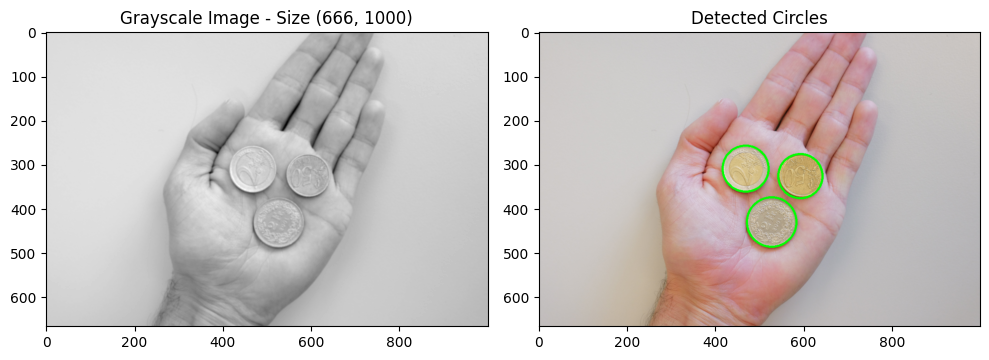

In [5]:
# Reading and resizing the image
image = cv2.imread(os.path.join(train_folder, train_subfolders[2], 'L1010373.JPG'), cv2.IMREAD_COLOR)
scale_percent = 1000 / max(image.shape[0], image.shape[1])  # scale to fit 1000px dimension
width = int(image.shape[1] * scale_percent)
height = int(image.shape[0] * scale_percent)
dim = (width, height)
resized_image = cv2.resize(image, dim, interpolation=cv2.INTER_AREA)

# Converting to grayscale and applying Gaussian blur
gray = cv2.cvtColor(resized_image, cv2.COLOR_BGR2GRAY)
gray = cv2.GaussianBlur(gray, (5, 5), 0)

# Plotting the grayscale image
plt.figure(figsize=(10, 5))  # Define the size of the figure
plt.subplot(1, 2, 1)  # This means 1 row, 2 columns, 1st subplot
plt.imshow(gray, cmap='gray')
plt.title(f'Grayscale Image - Size {gray.shape}')

# Finding circles in the image
output = resized_image.copy()
maxRadius = 65
minRadius = 20
circles = cv2.HoughCircles(image=gray, 
                           method=cv2.HOUGH_GRADIENT, 
                           dp=1.2, 
                           minDist=2*minRadius,
                           param1=50,
                           param2=50,
                           minRadius=minRadius,
                           maxRadius=maxRadius)

# Drawing the circles
if circles is not None:
    circlesRound = np.round(circles[0, :]).astype("int")
    for (x, y, r) in circlesRound:
        cv2.circle(output, (x, y), r, (0, 255, 0), 4)

    plt.subplot(1, 2, 2)  # 1 row, 2 columns, 2nd subplot
    plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB), cmap='gray')  # Convert back to RGB for displaying
    plt.title('Detected Circles')
else:
    print('No circles found')

plt.tight_layout()
plt.show()


As cv2.HoughCircles required one channel (not necessarily converting the image to grayscale), in the cell below we experiment to find what channels may deem most appropriate.

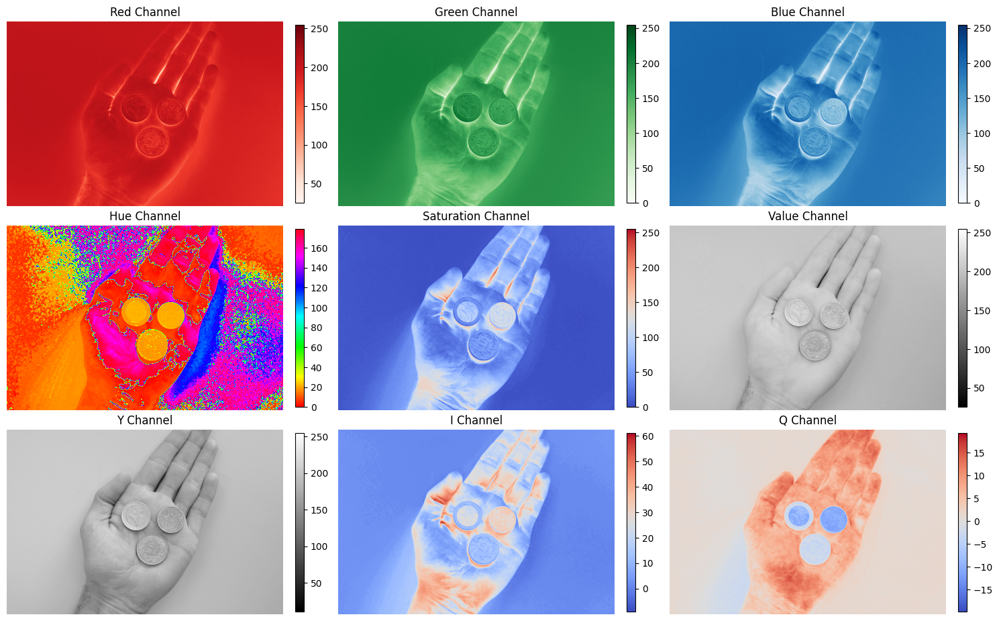

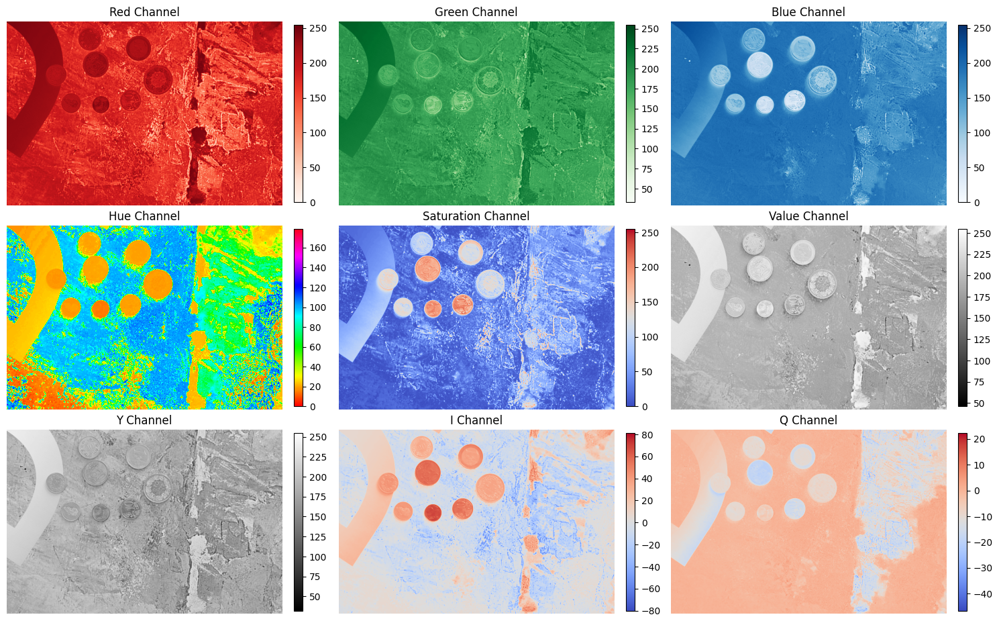

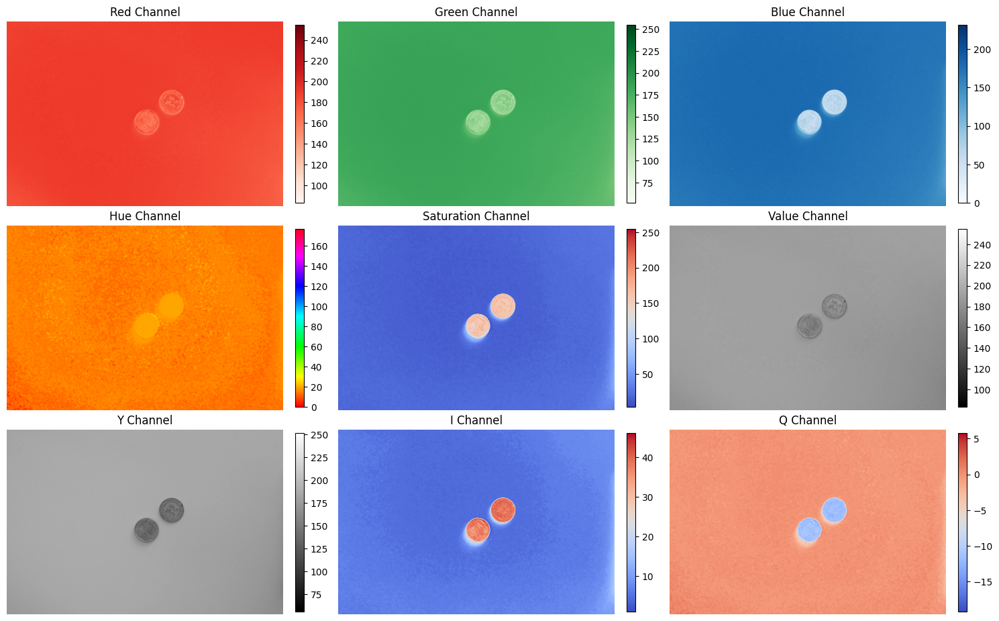

In [30]:
def plot_9_channels(image):
    # OpenCV reads images in BGR format, not RGB
    # Split the image into its channels
    B, G, R = cv2.split(image)

    # Convert BGR to HSV
    image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Split into the H, S, and V channels
    H, S, V = cv2.split(image_hsv)

    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Define the transformation matrix from RGB to YIQ
    transform_matrix = np.array([[0.299, 0.587, 0.114],
                                [0.596, -0.274, -0.322],
                                [0.211, -0.523, 0.312]])

    # Apply the transformation matrix
    yiq = np.dot(image_rgb, transform_matrix.T)
    yiq[:, :, 1:] = (yiq[:, :, 1:] + 0.5957) / 1.1914  # Normalize I and Q between 0 and 1

    # Prepare figures and axes
    fig, axes = plt.subplots(3, 3, figsize=(15, 15))
    titles = ['Red Channel', 'Green Channel', 'Blue Channel',
            'Hue Channel', 'Saturation Channel', 'Value Channel',
            'Y Channel', 'I Channel', 'Q Channel']
    channels = [R, G, B, H, S, V, yiq[:, :, 0], yiq[:, :, 1], yiq[:, :, 2]]
    cmaps = ['Reds', 'Greens', 'Blues', 'hsv', 'coolwarm', 'gray', 'gray', 'coolwarm', 'coolwarm']

    # Plot each channel
    for i, ax in enumerate(axes.flat):
        im = ax.imshow(channels[i], cmap=cmaps[i])
        ax.set_title(titles[i])
        ax.axis('off')
        cbar = fig.colorbar(im, ax=ax, fraction=0.03, pad=0.04)  # Adjusted colorbar size

    plt.subplots_adjust(hspace=-0.8, wspace=0.1)  # Reduce horizontal and vertical spacing

    plt.tight_layout()
    plt.show()
    return image_hsv, yiq

image_hand = cv2.imread(os.path.join(train_folder, train_subfolders[2], 'L1010373.JPG'), cv2.IMREAD_COLOR)
image_hsv_hand, yiq_hand = plot_9_channels(image_hand)
image_noisy = cv2.imread(os.path.join(train_folder, train_subfolders[1], 'L1010367.JPG'), cv2.IMREAD_COLOR)
image_hsv_noisy, yiq_noisy = plot_9_channels(image_noisy)
image_neutral = cv2.imread(os.path.join(train_folder, train_subfolders[3], 'L1010418.JPG'), cv2.IMREAD_COLOR)
image_hsv_neutral, yiq_neutral = plot_9_channels(image_neutral)

If we were on a segmentation task, we observe that for `hand`, the Q channel best separates the coins from the background. For `neutral`, pretty much any channel would separate the coins from the background, and for `noisy`, either the I, Q, or Hue channel seem to separate the coins (although part of the background is preserved).

However, experimented with several channels, and observed that for `hand`, cv2.HoughCircles best identified the coins when using the **Y** channel, and for `noisy` the **I** channel revealed the best results. For the `neutral` background, there were no particular differences among the channels, so for simplicity, we used also the **Y** channel

Now the goal is to be able to differentiate between noisy images and the rest. We can do that by observing the Hue channel. See that `neutral` are predominantly 'orange', `hand` also have a very high proportion of 'orange' (>50% of the pixels), while the `noisy`, while still having a significant amount of 'orange' pixels, it is a much lower proportion than the rest. These 'orange' pixels in the Hue channels of the images above basically mean very low values of Hue (say <20).

In the cell below we plot the proportion of 'orange' pixels for each background.

In [48]:
def calculate_perc_low_H(input_folder):
    data = []
    labels = []

    for folder in os.listdir(input_folder):
        if folder.startswith('.'):
            continue

        perc_low_H = []
        child_folder = os.path.join(input_folder, folder)

        for filename in os.listdir(child_folder):
            if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                image_path = os.path.join(child_folder, filename)
                image = cv2.imread(image_path, cv2.IMREAD_COLOR)
                image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
                H = image_hsv[:, :, 0]
                perc_low_H.append((H < 20).mean())

        if perc_low_H:
            data.append(perc_low_H)
            labels.append(folder)

    # Plotting the box plot
    plt.figure(figsize=(10, 5))
    plt.boxplot(data, labels=labels, vert=False)
    plt.title('Distribution of Low Hue Values (<20)')
    plt.tight_layout()
    plt.show()

    # Zip the labels and data together
    zipped_lists = list(zip(labels, data))

    # Sort the zipped list based on the numeric value extracted from the labels
    zipped_lists.sort(key=lambda x: int(x[0].split('. ')[0]))

    # Unzip back to separate lists
    sorted_labels, sorted_data = zip(*zipped_lists)

    return sorted_data, sorted_labels

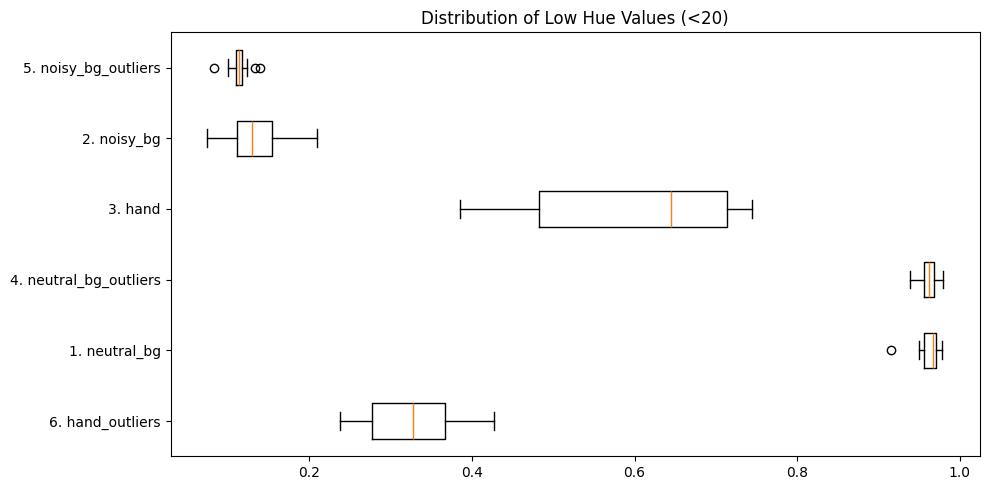

In [49]:
data, labels = calculate_perc_low_H(train_folder)

We observe that the distributions do not overlap. We choose as threshold the middle point between the highest proportion of `noisy` images and the lowest proportion of `hand` images.

In [50]:
labels

('1. neutral_bg',
 '2. noisy_bg',
 '3. hand',
 '4. neutral_bg_outliers',
 '5. noisy_bg_outliers',
 '6. hand_outliers')

In [51]:
threshold = np.mean([np.max(data[1]), np.min(data[5])])
threshold

0.223839

We will use the threshold above to choose what channel to use (whether Y or I) to find the circles.

## 1.2. Create Patches

Extract patches of individual coins of the train data. 

By using the techniques analyzed above, we create so called "patches", detecting the coins and saving each coin into a single image.

**Please set `Create_patches` to True, if you want to run this function.**

In [20]:
create_patches = True

5 main functions are used in the following code:

1. **get_one_channel_image(image_path, scale_percent = 20)**

2. **remove_concentric_circles(circles, center_threshold=10)**

3. **save_image_with_circles(output_images_path, image, circles)**:

4. **save_patches(image_path, output_patches_path, image, circles, scale_percent)**:

5. **process_image(image_path, output_images_path, output_patches_path)**:

As explained before, we need to resize the images:

In [45]:
scale_percent = 20

1. **get_one_channel_image(image_path, scale_percent = 20)**

As explained before, we need to pass just one channel to the function cv2.HoughCircles. Here, we:

- Open each image file

- Resize the image

- Convert it from BGR to RGB, and then to both HSV and YIQ

- Using the Hue channel, we identify if it has noisy, neutral, or hand background.

- Based on the background type, we extract either the Y channel (neutral/hand), or the I channel (noisy).

- We also return the information on whether the image has noisy background. This will be useful for identifying the circles (explained later).

In [40]:
def get_one_channel_image(image_path, scale_percent = 20):
    random.seed(42)
    # Read the image in BGR format
    image = cv2.imread(image_path, cv2.IMREAD_COLOR)
    
    # Resize the image
    width = int(image.shape[1] * scale_percent / 100)
    height = int(image.shape[0] * scale_percent / 100)
    dim = (width, height)
    resized_image = cv2.resize(image, dim, interpolation=cv2.INTER_AREA)
    
    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB)

    # Convert BGR to HSV
    image_hsv = cv2.cvtColor(resized_image, cv2.COLOR_BGR2HSV)

    # Split into the H, S, and V channels 
    H, _, _ = cv2.split(image_hsv)

    # Define the transformation matrix from RGB to YIQ
    transform_matrix = np.array([[0.299, 0.587, 0.114],
                                 [0.596, -0.274, -0.322],
                                 [0.211, -0.523, 0.312]])
    
    # Apply the transformation matrix
    yiq = np.dot(image_rgb, transform_matrix.T)
    
    # Determine if the image is noisy or not - see in 9 channels above that noise has the lowest percentage of low H values
    if(np.mean(H < 20) < threshold):
        # if the image is  noisy, select the I channel
        yiq_selected_channel = yiq[:, :, 1]
        noisy = True
    else:
        # if the image is not noisy, select the Y channel
        yiq_selected_channel = yiq[:, :, 0]
        noisy = False

    return image, yiq_selected_channel, noisy

2. **remove_concentric_circles(circles, center_threshold=10)**

Some coins, for example 1EUR and 2EUR coins, can be counted as two circles (inner and outer circles). However, as we are saving the image inside each circle, in those cases we would be saving two images, when indeed there is only one coin.

To solve this, we need to save only the outside circle (the bigger one). We do so by calculating if the centers of two circles are too close to each other.

In [41]:
def remove_concentric_circles(circles, center_threshold=10):
    random.seed(42)
    filtered_circles = []
    circles = np.round(circles[0, :]).astype("int")

    for i in range(len(circles)):
        x1, y1, r1 = circles[i]
        keep = True
        for j in range(len(circles)):
            if i != j:
                x2, y2, r2 = circles[j]
                distance = np.sqrt((x1 - x2) ** 2 + (y1 - y2) ** 2)
                
                if distance < center_threshold:
                    # Keep the larger circle
                    if r1 < r2:
                        keep = False
                        break
        if keep:
            filtered_circles.append(circles[i])

    return np.array(filtered_circles)

3. **save_image_with_circles(output_images_path, image, circles)**

This function takes detected circles, applies the `remove_concentric_circles` function to clean up the results, and then draws these circles onto the image. Each detected coin is marked with a red circle, visually highlighting the coins. The processed image is then saved to the specified path. You can check this behavior in the `PROCESSED` folder.

In [42]:
def save_image_with_circles(output_images_path, image, circles):
    random.seed(42)
    if circles is not None:
        scale_percent = 20
        filtered_circles = remove_concentric_circles(circles)
        scaled_circles = filtered_circles * int(100 / scale_percent)

        for _, (x, y, r) in enumerate(scaled_circles):

            cv2.circle(image, (x, y), r, (255, 0, 0), 4)
            cv2.circle(image, (x, y), 2, (255, 0, 0), 3)
        
    # Save the processed image
    cv2.imwrite(output_images_path, image)

4. **save_patches(image_path, output_patches_path, image, circles, scale_percent)**

This function extracts patches from the image based on the circles' centers are radius. Basically, it takes a square centered at the circle center and sized by its radius (we take a 1.15 multiplier of the radius to ensure we do not crop part of the coin if the circle is not perfectly circumscript to the coin).

Another important consideration is that we believe size to be an important factor to identify coins. Therefore, we do not want to lose that information. However, as the future classification will require every image to be the same size, we would have to resize the coins. To avoid this, we pad with 0s all the coins, centering them in a bigger square of size 1000x1000 (which we have ensured to not be bigger than any of the coins). This way, all the patches have the same size (1000x1000), while still being able to differentiate the size of the coins.

In [43]:
def save_patches(image_path, output_patches_path, image, circles, scale_percent):
    random.seed(42)
    if circles is not None:
        filtered_circles = remove_concentric_circles(circles)
        scaled_circles = filtered_circles * int(100 / scale_percent)

        for idx, (x, y, r) in enumerate(scaled_circles):
            # Add some padding to the radius
            r = int(r * 1.15)

            # Create a mask to extract the patch
            mask = np.zeros_like(image, dtype=np.uint8)
            cv2.circle(mask, (x, y), int(r), (255, 255, 255), thickness=-1)
            masked_image = cv2.bitwise_and(image, mask)

            # Calculate the top-left and bottom-right corners of the square
            top_left_x = max(x - r, 0)
            top_left_y = max(y - r, 0)
            bottom_right_x = min(x + r, image.shape[1])
            bottom_right_y = min(y + r, image.shape[0])

            # Extract the patch
            patch = masked_image[top_left_y:bottom_right_y, top_left_x:bottom_right_x]

            # Create a new 1000x1000 pixel background (Max size of the patches is 1000x1000 pixels)
            final_patch = np.zeros((1000, 1000, 3), dtype=np.uint8)

            # Calculate centering position on the 908x908 image
            start_x = (1000 - (bottom_right_x - top_left_x)) // 2
            start_y = (1000 - (bottom_right_y - top_left_y)) // 2

            # Place the extracted patch in the center of the new 908x908 image
            final_patch[start_y:start_y + patch.shape[0], start_x:start_x + patch.shape[1]] = patch

            # Save the patch to the specified directory
            patch_filename = f"{os.path.splitext(os.path.basename(image_path))[0]}_patch_{idx+1}.jpg"
            patch_path = os.path.join(output_patches_path, patch_filename)
            cv2.imwrite(patch_path, final_patch)


5. **process_image(image_path, output_images_path, output_patches_path)**:

This overarching function handles the complete process extracting patches.

- Gets the one-channel image (resized).

- Normalizes the channel.

- Applies Gaussian blur to remove noise.

- Detects circles:

    - We set a conservative min and max size of circles to radius between 15 and 85 pixels.

    - The parameters of the HoughCircles function determine how strict the function is with what is considered a circle. We observed that in the hand background, the fingertips were sometimes identified as circles, while in the noise background, some circles were harder to identify. To solve this, we make the function slightly "more strict" with images not noisy, as set by `param2=0.9 - 0.02 * noisy`.

- We save both the image with circles (PROCESSED images), and the individual coin patches (PATCHES).

In [44]:
def process_image(image_path, output_images_path, output_patches_path):
    random.seed(42)
    scale_percent = 20
    image, yiq_selected_channel, noisy = get_one_channel_image(image_path, scale_percent)
    
    # Normalize the channel
    yiq_selected_channel_normalized = cv2.normalize(yiq_selected_channel, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
    
    # Convert to uint8 and apply GaussianBlur
    yiq_selected_channel_uint8 = np.uint8(yiq_selected_channel_normalized)
    blurred_image = cv2.GaussianBlur(yiq_selected_channel_uint8, (9, 9), 1)
    
    # Detect circles using HoughCircles
    maxRadius = 85
    minRadius = 15

    # Detect circles
    circles = cv2.HoughCircles(blurred_image, 
                               cv2.HOUGH_GRADIENT_ALT, 
                               dp=1.5, 
                               minDist=2*minRadius,
                               param1=120,
                               param2=0.9 - 0.02 * noisy,
                               minRadius=minRadius,
                               maxRadius=maxRadius)

    # Save the image with the detected circles
    save_image_with_circles(output_images_path, image.copy(), circles)

    # Save the patches
    save_patches(image_path, output_patches_path, image.copy(), circles, scale_percent)

## 1.3. Run for the training sets

In [45]:
def create_patches_and_processed_images(input_folder, processed_folder = 'PROCESSED', patches_folder = 'PATCHES'):
    # Set the random seed to ensure reproducibility
    random.seed(42)
    for folder in os.listdir(input_folder):

        if folder.startswith('.'):
            continue

        child_folder = os.path.join(input_folder, folder)
        output_images_folder = os.path.join(processed_folder, folder)
        output_patches_folder = os.path.join(patches_folder, folder)

        print(folder, '\n')

        # Create output folder if it doesn't exist
        if not os.path.exists(output_images_folder):
            os.makedirs(output_images_folder)

        # Create output folder if it doesn't exist
        if not os.path.exists(output_patches_folder):
            os.makedirs(output_patches_folder)

        for filename in tqdm(os.listdir(child_folder)):
            if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                input_path = os.path.join(child_folder, filename)
                output_images_path = os.path.join(output_images_folder, filename)
                process_image(input_path, output_images_path, output_patches_folder)

#### TRAINING SET

The cell below may take any time between 30s to 5min to run.

In [52]:
processed_folder = 'PROCESSED'
patches_folder = 'PATCHES'

if create_patches:
    random.seed(42)
    create_patches_and_processed_images(train_folder)

6. hand_outliers 



100%|██████████| 7/7 [00:11<00:00,  1.66s/it]


1. neutral_bg 



100%|██████████| 16/16 [00:36<00:00,  2.29s/it]


4. neutral_bg_outliers 



100%|██████████| 17/17 [00:25<00:00,  1.47s/it]


3. hand 



100%|██████████| 10/10 [00:13<00:00,  1.37s/it]


2. noisy_bg 



100%|██████████| 15/15 [00:26<00:00,  1.74s/it]


5. noisy_bg_outliers 



100%|██████████| 16/16 [00:25<00:00,  1.62s/it]


Check that all images have the same size (needed for classification). To be able to differentiate coins based on size, instead of resizing the images, we included a black border in all the images to fix them to a certain size.

In [30]:
def check_image_sizes(folder_path, desired_size=(1000, 1000)):
    all_correct = True
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif')):
                image_path = os.path.join(root, file)
                with Image.open(image_path) as img:
                    if img.size != desired_size:
                        print(f"{file} is NOT {desired_size[0]}x{desired_size[1]} pixels. Current size: {img.size}")
                        all_correct = False

    if all_correct:
        print("All images are correctly sized.")
    else:
        print("Some images do not match the desired size.")


# Usage
combined_patches_folder = 'PATCHES/COMBINED'
check_image_sizes(combined_patches_folder)

All images are correctly sized.


Get all the patches into the same folder (currently they are in 6 separate folders), as in the data provided.

In [54]:
# Path to the new COMBINED folder
combined_dir = os.path.join(patches_folder, 'COMBINED') ##CHANGED FROM processed_folder to patches_folder
# combined_dir = os.path.join(processed_folder, 'COMBINED')      

# Create the COMBINED folder if it doesn't exist
if not os.path.exists(combined_dir):
    os.makedirs(combined_dir)

# Iterate over each subfolder and copy images to the COMBINED folder
for subfolder in train_subfolders:
    subfolder_path = os.path.join(patches_folder, subfolder)
    for filename in os.listdir(subfolder_path):
        file_path = os.path.join(subfolder_path, filename)
        if os.path.isfile(file_path):  # Check if it is a file
            shutil.copy(file_path, combined_dir)  # Copy file to the COMBINED folder

print("All images have been copied to the COMBINED folder.")

All images have been copied to the COMBINED folder.


#### Additional Notes:

The cell below allows to process only specific images. To use it, create a folder `problematic`, and include all the images you want to process.

In [ ]:
'''
# Folder paths
input_folder = 'problematic'
output_images_folder = 'problematic_patches'
output_patches_folder = 'problematic_patches'

# Create output folder if it doesn't exist
if not os.path.exists(output_images_folder):
    os.makedirs(output_images_folder)

# Create output folder if it doesn't exist
if not os.path.exists(output_patches_folder):
    os.makedirs(output_patches_folder)

# Process each image in the folder
for filename in os.listdir(input_folder):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        input_path = os.path.join(input_folder, filename)
        output_images_path = os.path.join(output_images_folder, filename)
        process_image(input_path, output_images_path, output_patches_folder)
'''

#### MANUAL ANNOTATION OF PATCHES

Now that we have all the coins extracted and in one image file each, we need to manually label them. The cell below is commented as they csv has already been filled out manually, and this cell would overwrite it with empty values. As describeed in the file structure, the file 'COMBINED_LABELS', containing all these labels, should be in this folder.

We annotated the CHF also as heads and tails. After some testing and given the huge amount classes that added, we observed it was better to do not differentiate between heads and tails.

In [ ]:
'''
# Define the directory to search for images
directory = 'PATCHES/TEST_SET_PATCHES'
output_csv = 'train_data.csv'

# Open a CSV file to write the paths
with open(output_csv, mode='w', newline='') as file:
    writer = csv.writer(file)
    # Write the header
    writer.writerow(['image'])

    # Walk through the directory and collect all filenames
    all_files = []
    for root, dirs, files in os.walk(directory):
        for filename in files:
            all_files.append(filename)

    # Sort the filenames
    sorted_files = sorted(all_files)

    # Write sorted filenames to the CSV file with label 0
    for filename in sorted_files:
        writer.writerow([filename])
'''

We created one csv for each folder to simply to better divide the task. Now we combine the 6 csv.

In [ ]:
'''
import pandas as pd

df1 = pd.read_csv('PATCHES/LABELS/train_hand_outliers_processed.csv')
df2 = pd.read_csv('PATCHES/LABELS/train_hand_processed.csv')
df3 = pd.read_csv('PATCHES/LABELS/train_neutral_bg_outliers_processed.csv')
df4 = pd.read_csv('PATCHES/LABELS/train_neutral_bg_processed.csv')
df5 = pd.read_csv('PATCHES/LABELS/train_noisy_bg_outliers_processed.csv')
df6 = pd.read_csv('PATCHES/LABELS/train_noisy_bg_processed.csv')

# Concatenate the two dataframes
combined_df = pd.concat([df1, df2, df3, df4, df5, df6], ignore_index=True)

# Save the combined dataframe to a new CSV file
combined_df.to_csv('PATCHES/COMBINED_LABELS.csv', index=False)
'''

# 2. Feature Extraction

Initially, we tried to manually extract features, by comparing color values, size, etc. One problem however is the detection of OOD.

Fortunately, we can employ the "magic" of deep learning, which learns to identify the features on the data.

In the cells below we show the feature extraction studies we used. However, note that in the final classification task we use the images themselves (with further processing that we'll explain later).

### Dataset class

In [27]:
class_names = {
    '5CHF': 0, '2CHF': 1, '1CHF': 2, '0.5CHF': 3, '0.2CHF': 4, '0.1CHF': 5, '0.05CHF': 6,
    '2EUR': 7, '1EUR': 8, '0.5EUR': 9, '0.2EUR': 10, '0.1EUR': 11, '0.05EUR': 12, '0.02EUR': 13, '0.01EUR': 14,
    'OOD': 15
}
reversed_class_names = {value: key for key, value in class_names.items()}

In [28]:
class CoinDataset(Dataset):
    def __init__(self, csv_file, root_dir, transform=None, train=True, class_to_num = True):
        """
        Args:
            csv_file (string): Path to the CSV file with annotations.
            root_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.annotations = csv_file
        self.root_dir = root_dir
        self.transform = transform
        self.train = train
        self.class_to_num = class_to_num

    def __len__(self):
        return len(self.annotations)

    def __getitem__(self, idx):
        # print(os.path.join(self.root_dir, self.annotations.iloc[idx, 0]))
        img_name = os.path.join(self.root_dir, self.annotations.iloc[idx, 0])
        if not os.path.exists(img_name):
            raise FileNotFoundError(f"Could not find file: {img_name}")

        image = Image.open(img_name)

        #Convert image to RGB if it's not (avoid issues with grayscale images)
        if image.mode != 'RGB':
            image = image.convert('RGB')

        if self.transform:
            image = self.transform(image)

        if self.train:
            label = self.annotations.iloc[idx, 1]
            if self.class_to_num:
                label = self.label_to_index(label)
            return image, label

        return image
    
    def label_to_index(self, label):        
        return class_names[label]


In [31]:
full_dataset = CoinDataset(
    csv_file=data_labels,
    root_dir=combined_patches_folder,
    transform=transforms.ToTensor(),
    class_to_num = False
)

if the next variable `large_check` is set to True, all the coins of the corresponding classes are printed visually.

In [32]:
large_check = True

Running code for coin: 5CHF


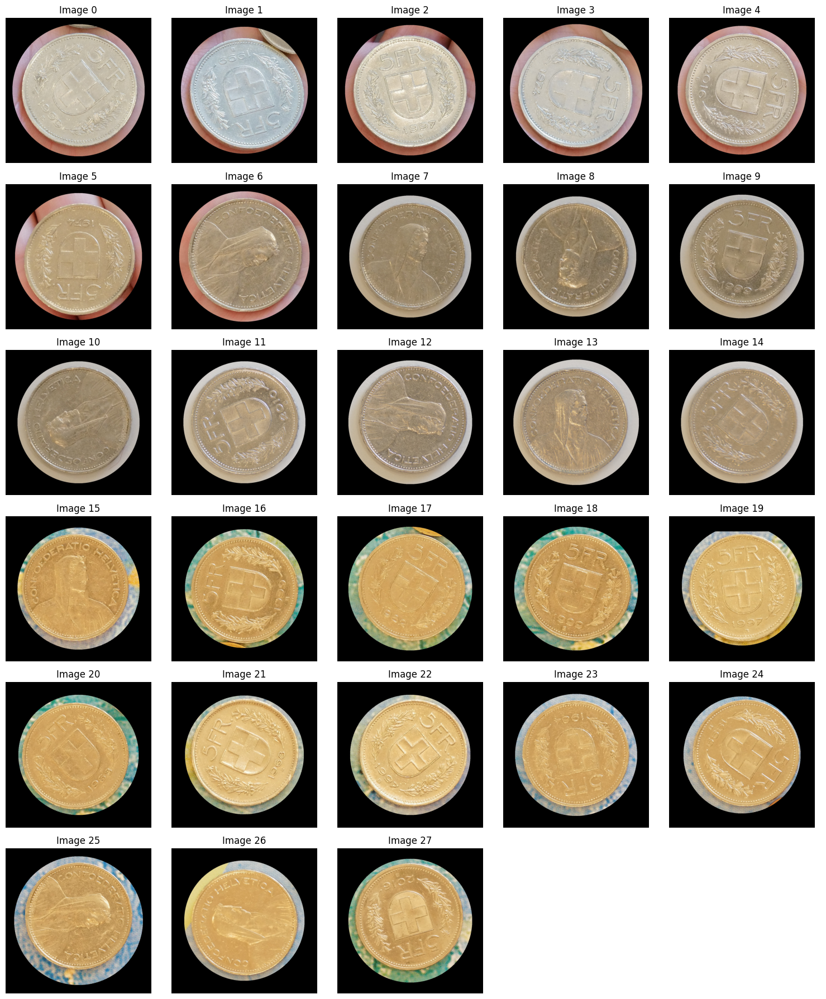

Running code for coin: 2CHF


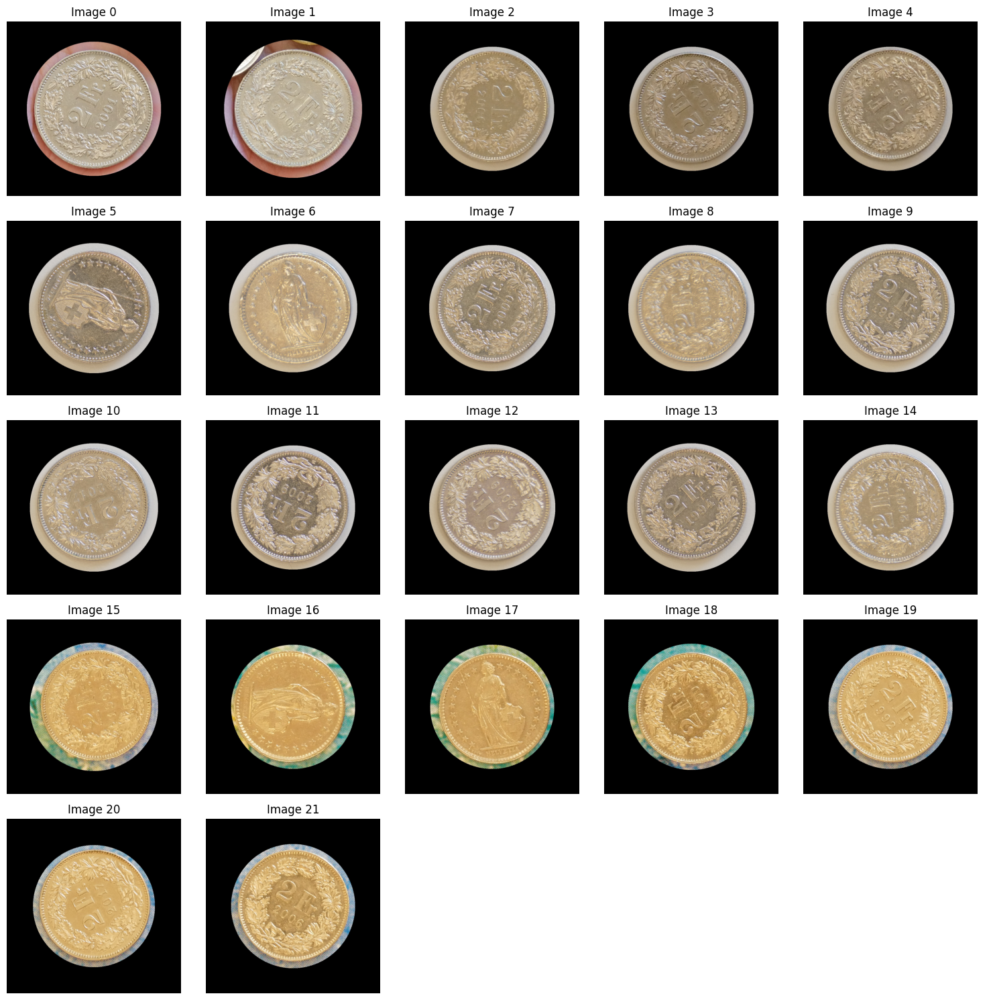

Running code for coin: 1CHF


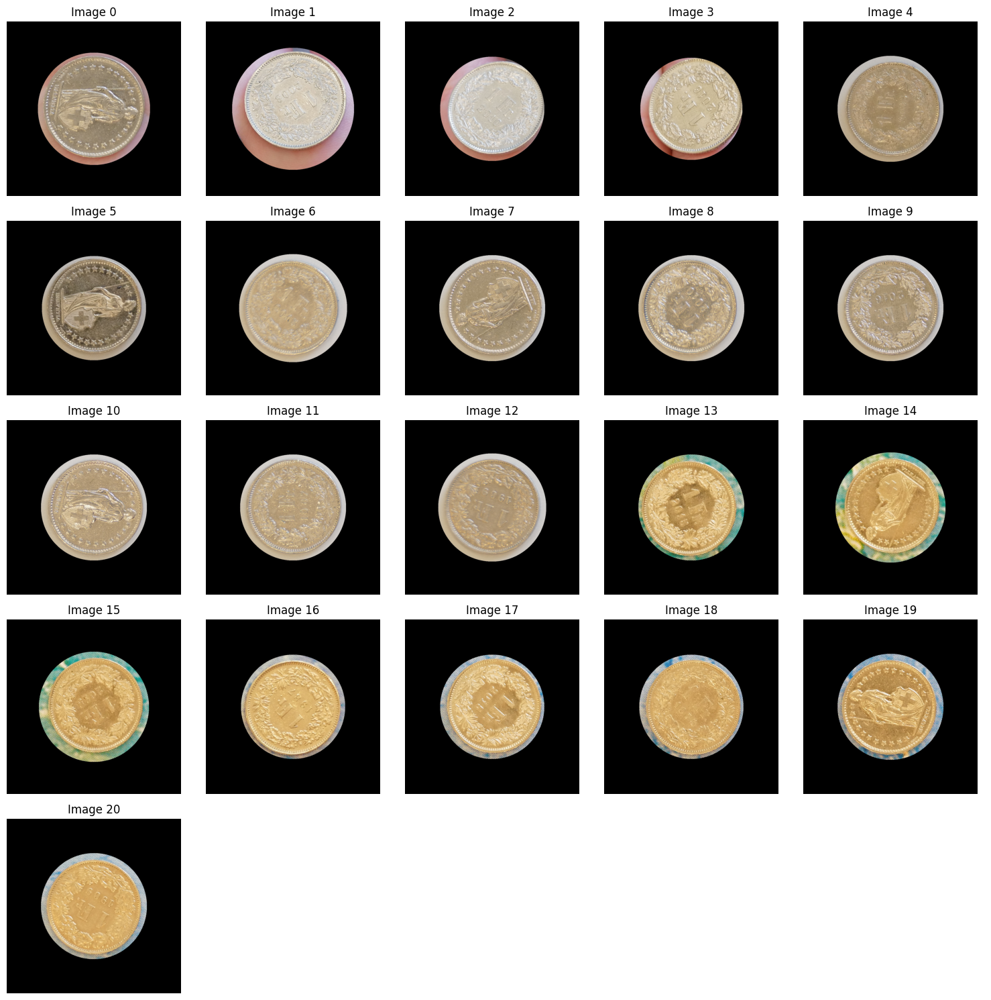

Running code for coin: 0.5CHF


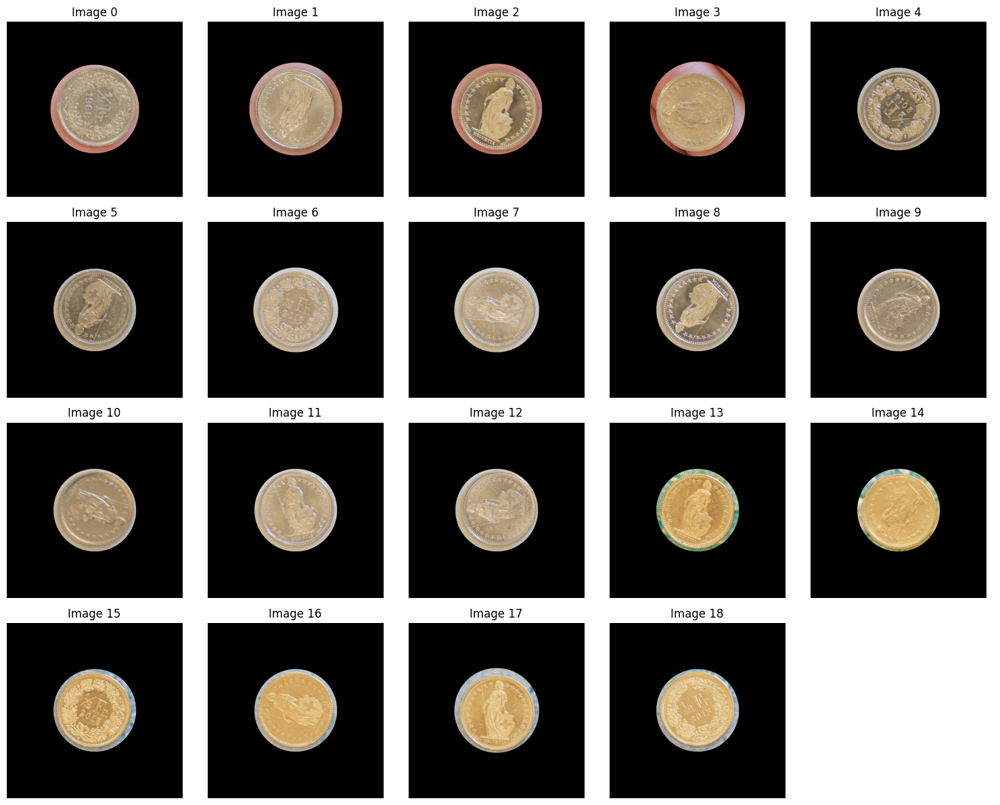

Running code for coin: 0.2CHF


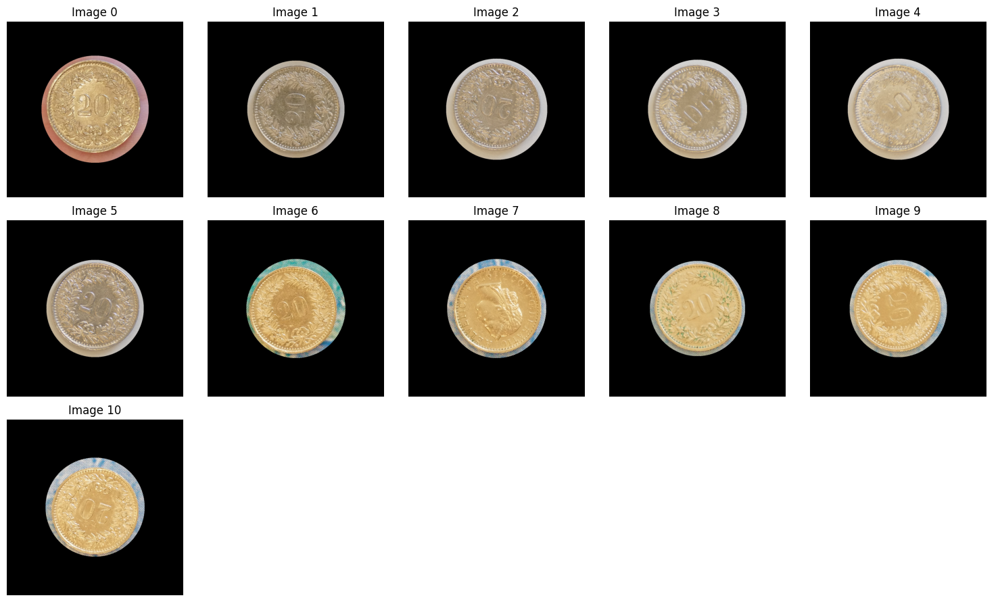

Running code for coin: 0.1CHF


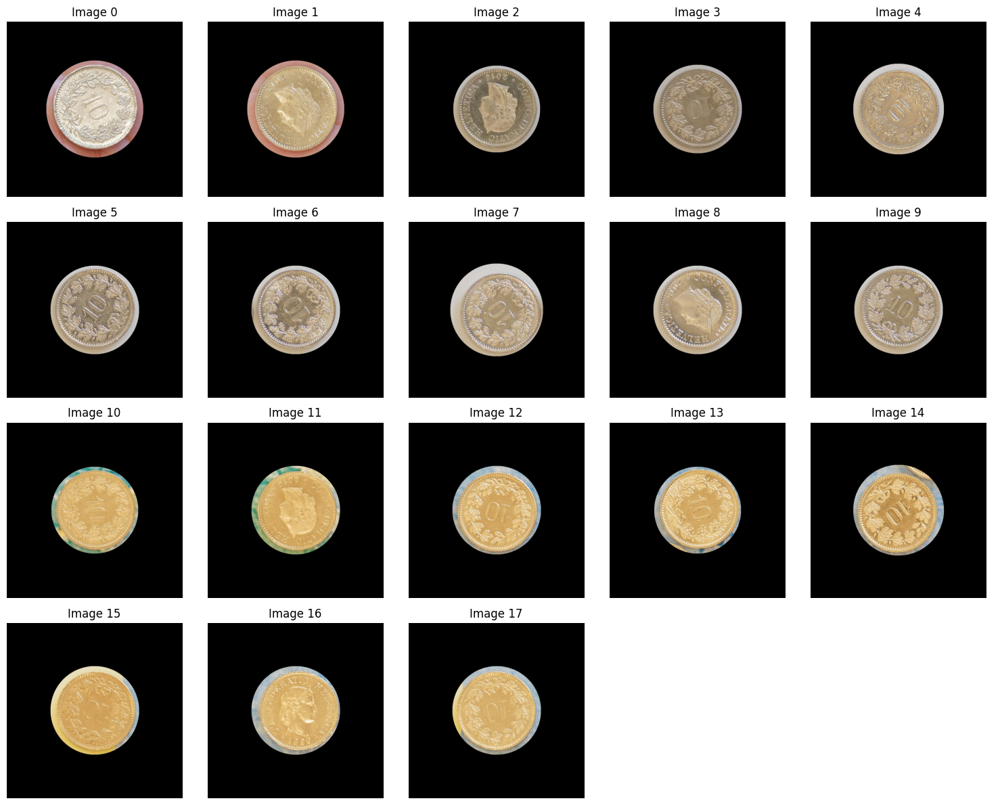

Running code for coin: 0.05CHF


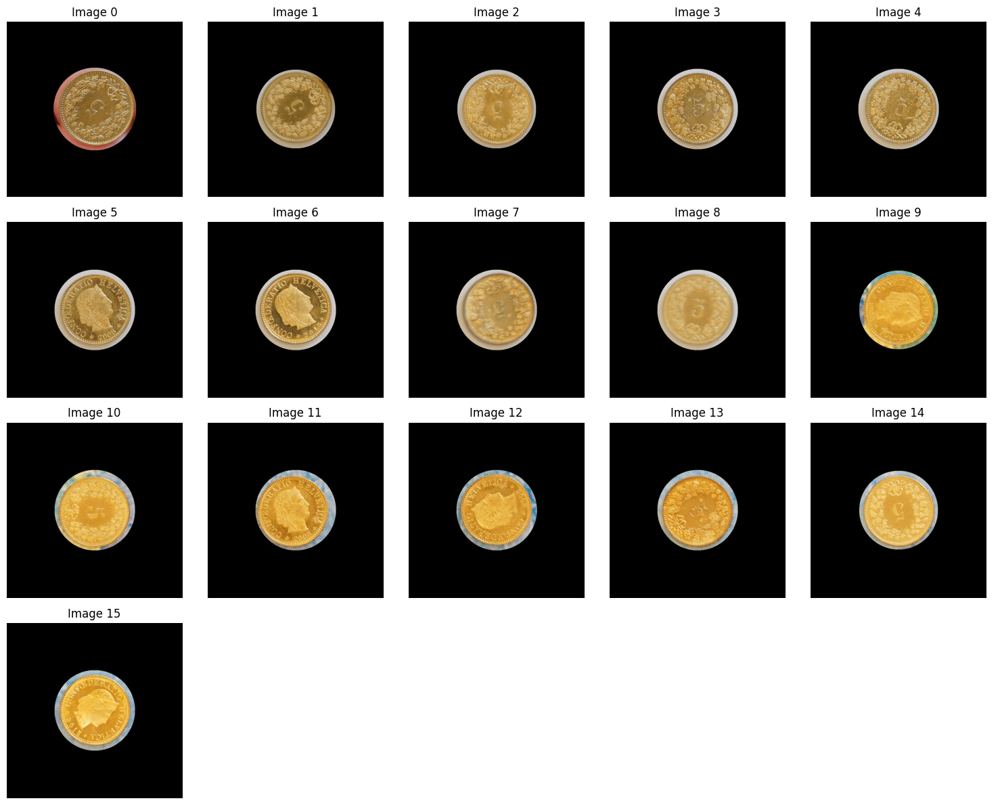

Running code for coin: 2EUR


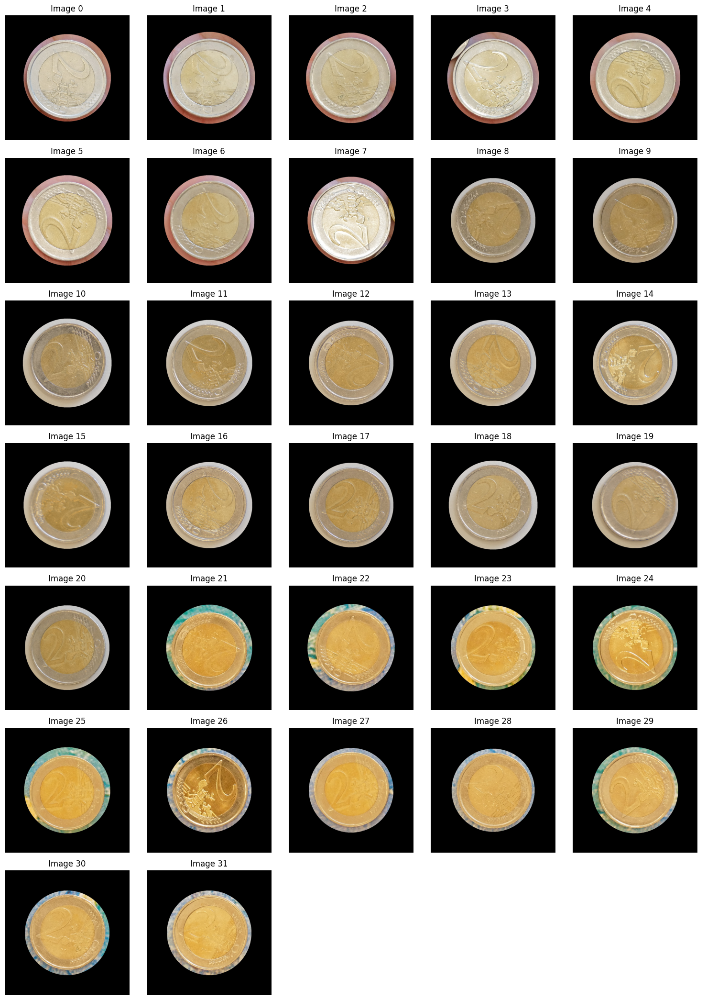

Running code for coin: 1EUR


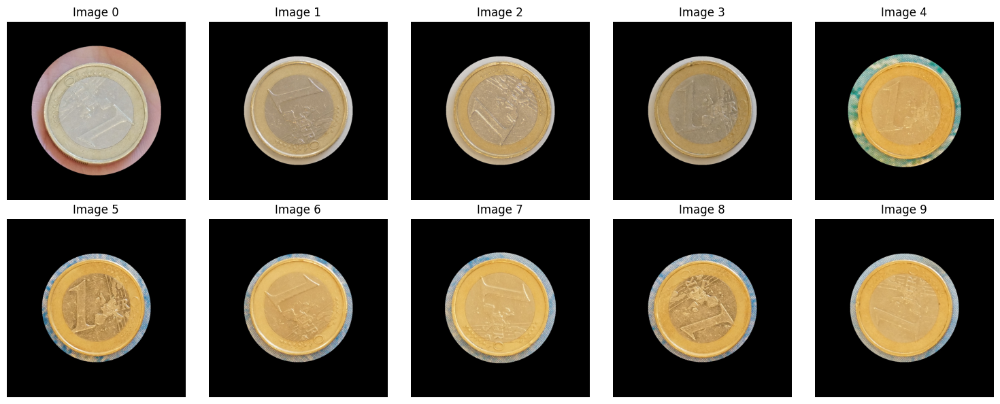

Running code for coin: 0.5EUR


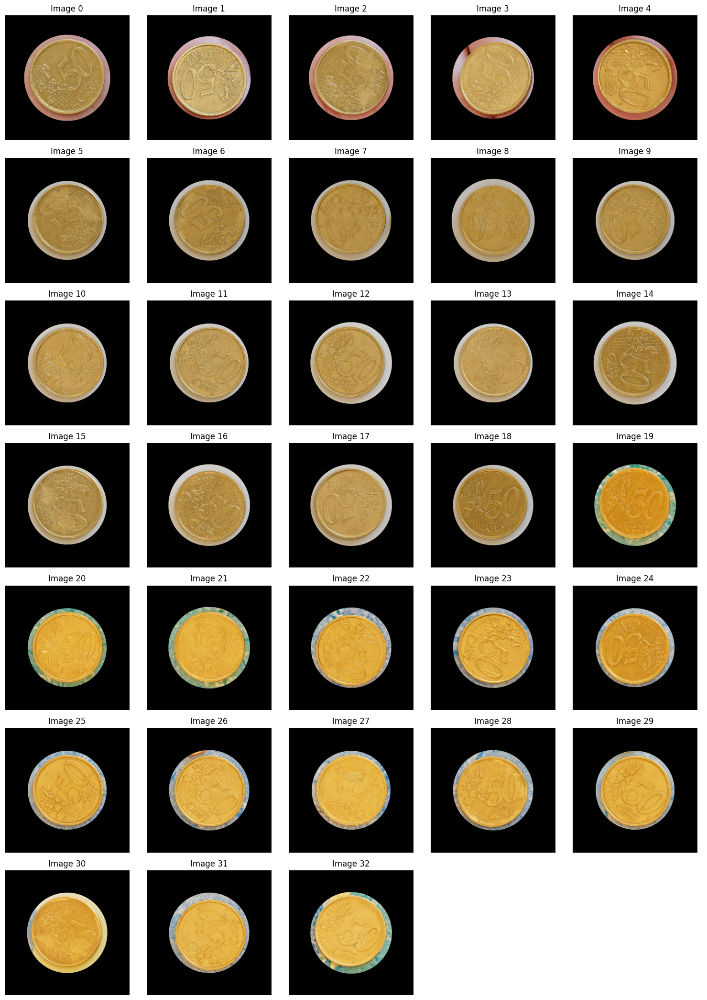

Running code for coin: 0.2EUR


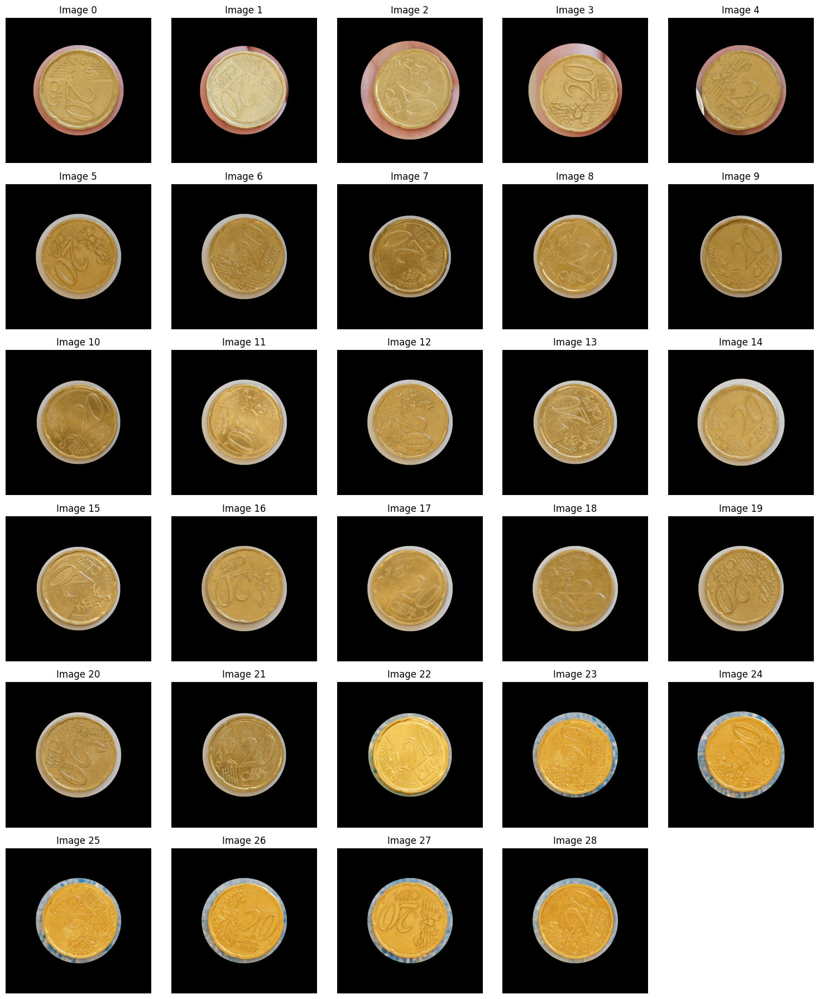

Running code for coin: 0.1EUR


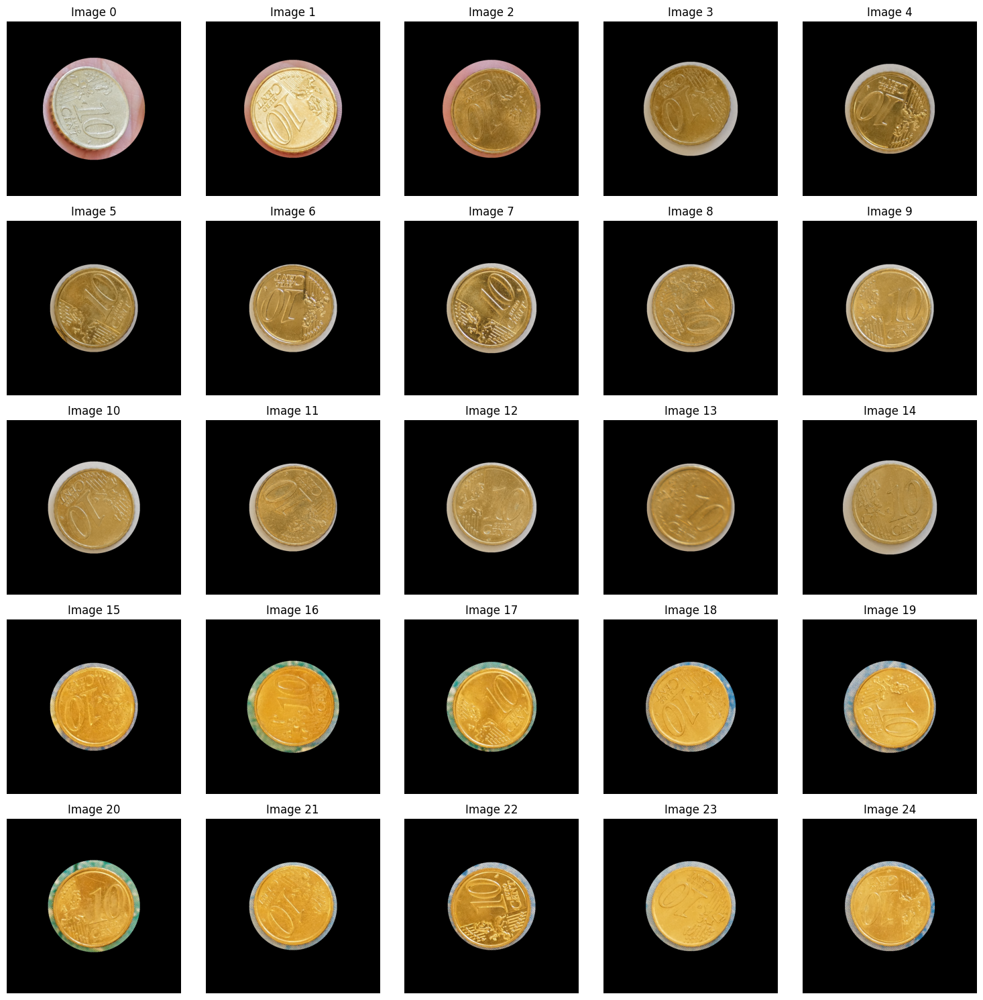

Running code for coin: 0.05EUR


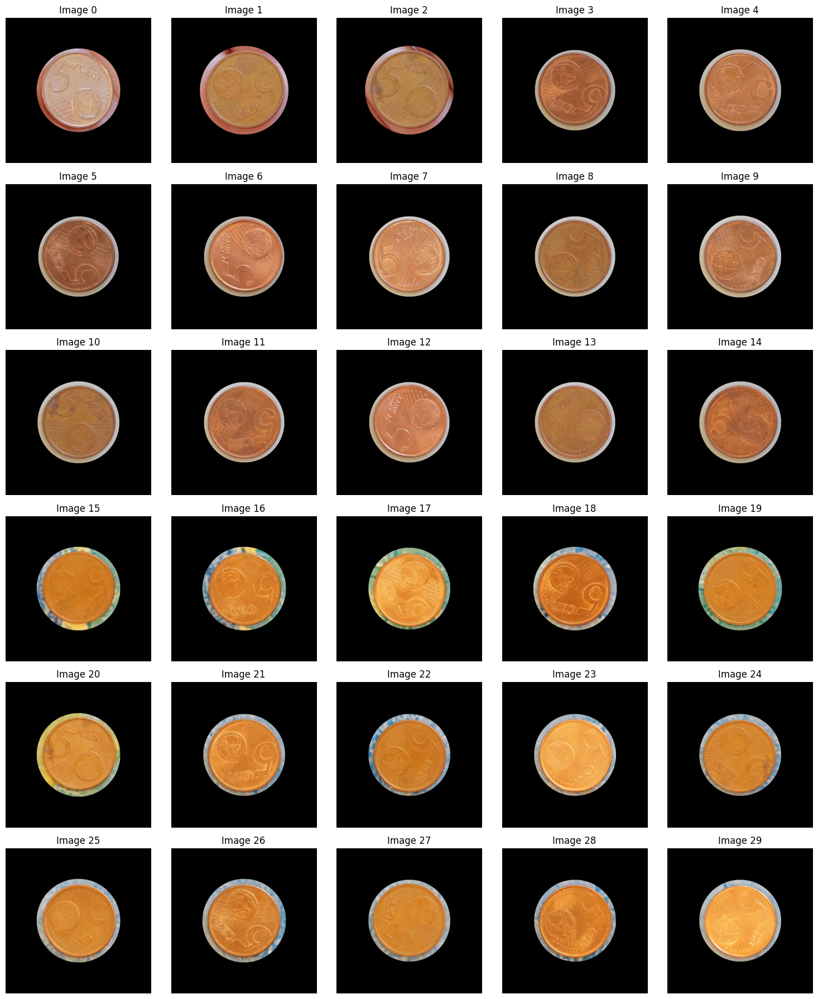

Running code for coin: 0.02EUR


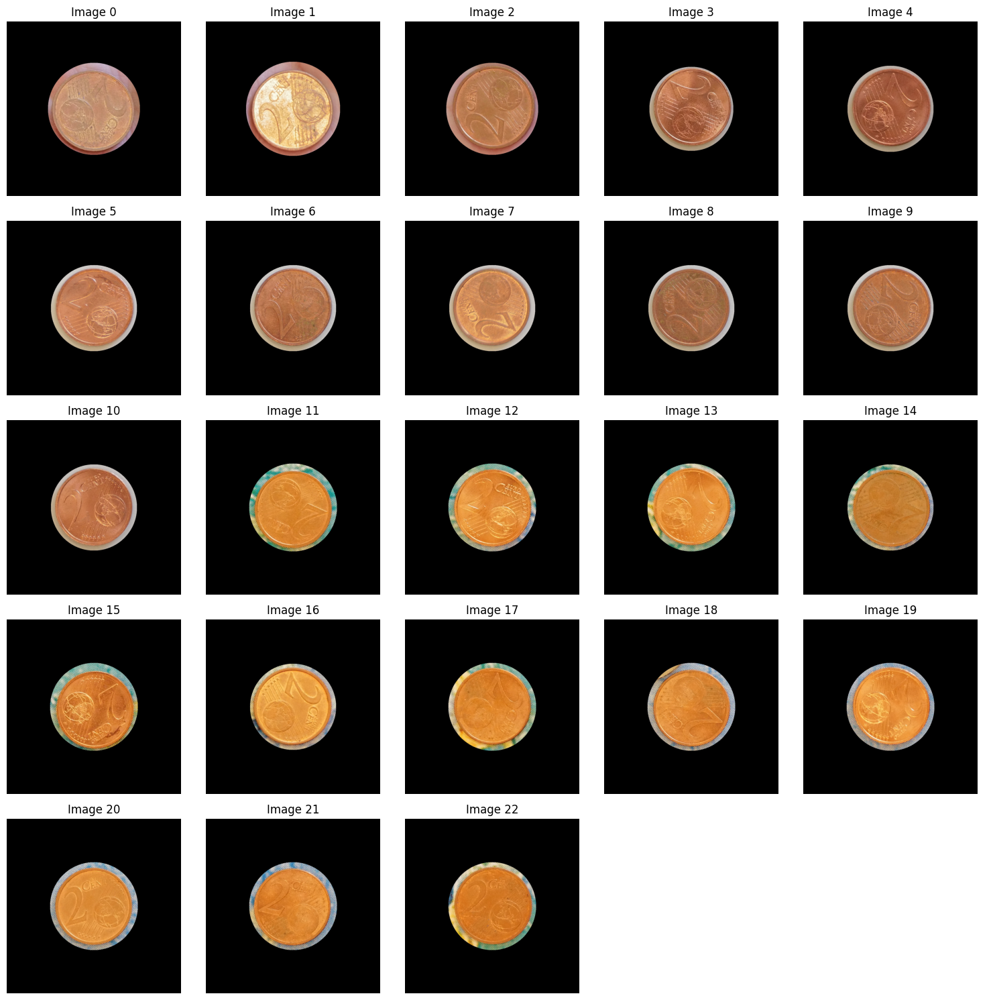

Running code for coin: 0.01EUR


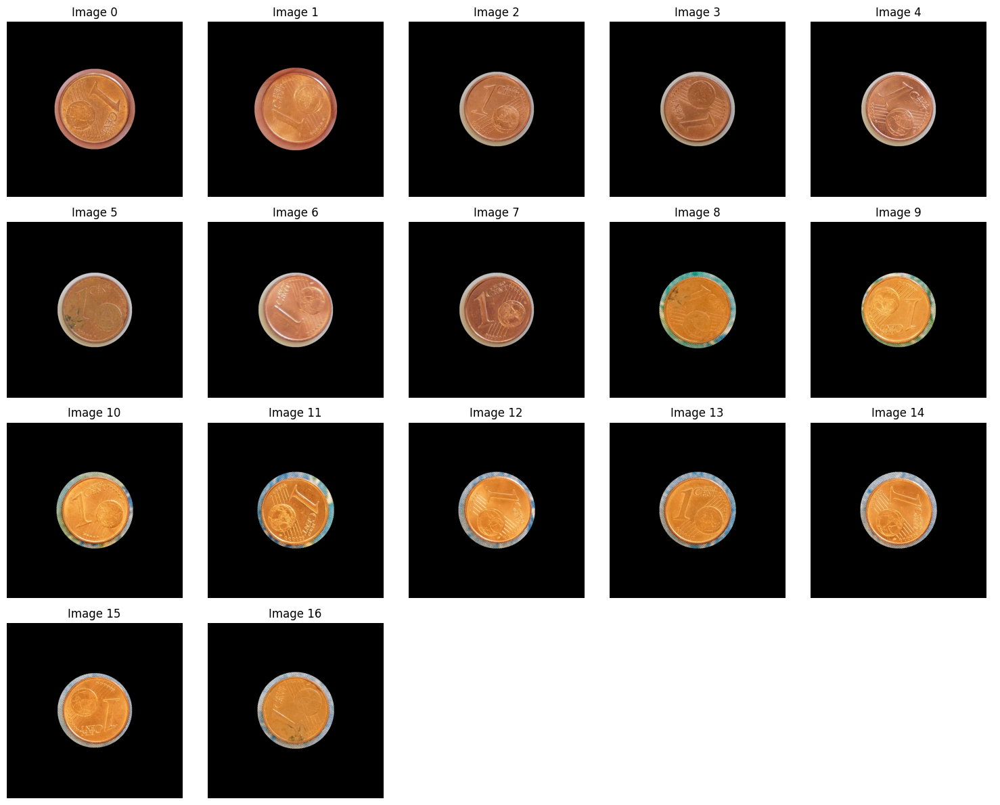

Running code for coin: OOD


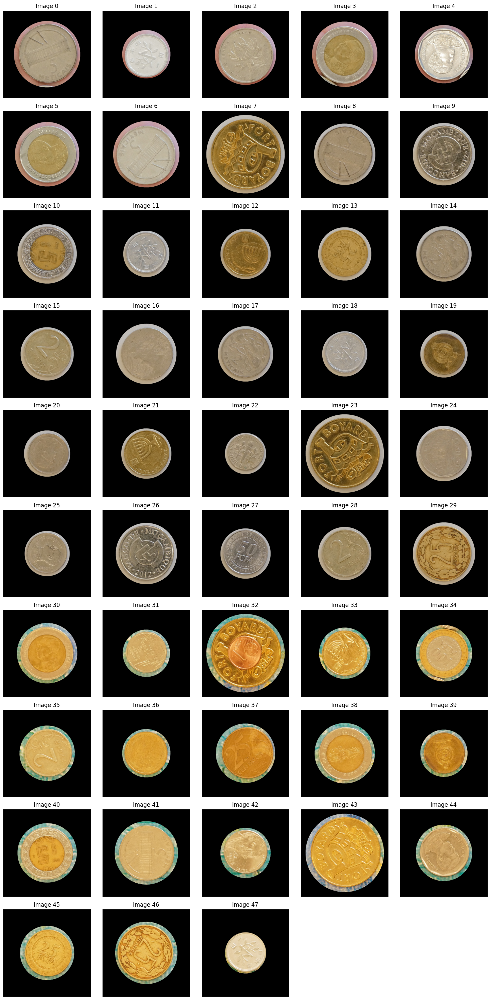

In [59]:
if large_check:
    label_map = {
        '5CHF': 0, '2CHF': 1, '1CHF': 2, '0.5CHF': 3, '0.2CHF': 4, '0.1CHF': 5, '0.05CHF': 6,
        '2EUR': 7, '1EUR': 8, '0.5EUR': 9, '0.2EUR': 10, '0.1EUR': 11, '0.05EUR': 12, '0.02EUR': 13, '0.01EUR': 14, 'OOD': 15
    }
    num_columns = 5

    for coin, label in label_map.items():
        print(f"Running code for coin: {coin}")

        # Filter the dataset to include only images with the current coin label
        ood_images = [full_dataset[i][0] for i in range(len(full_dataset)) if full_dataset[i][1] == coin]

        # Calculate the number of rows needed
        num_rows = len(ood_images) // num_columns + (len(ood_images) % num_columns > 0)

        # Create a figure and a set of subplots
        fig, axs = plt.subplots(num_rows, num_columns, figsize=(15, 3 * num_rows))

        # Flatten the axes array for easy iteration
        axs = axs.flatten()

        # Loop through each OOD image and each subplot axis
        for i, ax in enumerate(axs):
            if i < len(ood_images):
                # Extract the tensor
                image_tensor = ood_images[i]

                # Check if the tensor has the right dimensions
                if image_tensor.ndim != 3:
                    raise ValueError(f"Image tensor at index {i} does not have 3 dimensions, it has {image_tensor.ndim}")

                # Convert tensor to numpy array if it isn't already
                if not isinstance(image_tensor, np.ndarray):
                    image_tensor = image_tensor.numpy()

                # Transpose the tensor to match (height, width, channels)
                image_tensor = np.transpose(image_tensor, (1, 2, 0))

                # Plot the image
                ax.imshow(image_tensor)
                ax.set_title(f"Image {i}")
                ax.axis('off')  # Hide the axis
            else:
                # Hide any extra subplots
                ax.axis('off')

        # Adjust layout
        plt.tight_layout()
        plt.show()


### Dataset Imbalance - Count Instances of Each Class

Let's see how many coins of each type we have.

In [60]:
def count_classes(dataset):
    
    # Create a dictionary to store counts for each label
    label_counts = {}

    # Iterate through the dataset
    for _, label in tqdm(dataset):
        if label in label_counts:
            label_counts[label] += 1
        else:
            label_counts[label] = 1
    
    return label_counts

# Now, you can use the DataLoader directly:
train_class_counts = count_classes(full_dataset)

100%|██████████| 382/382 [00:06<00:00, 58.39it/s]


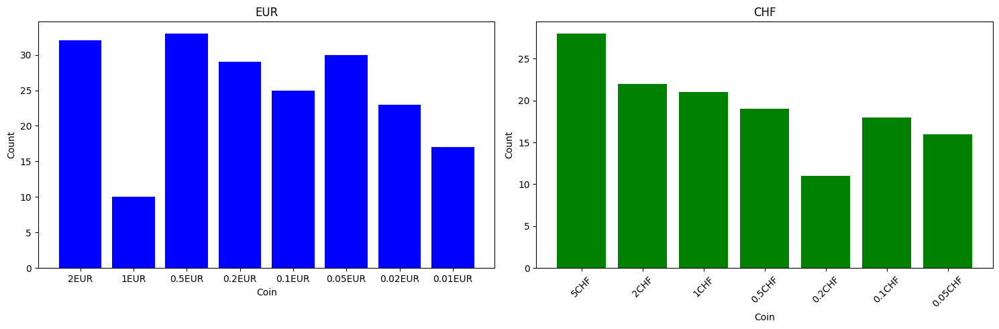

In [61]:
eur_counts = {k: v for k, v in train_class_counts.items() if 'EUR' in k}
chf_counts = {k: v for k, v in train_class_counts.items() if 'CHF' in k}
ood_counts = {'OOD': train_class_counts['OOD']}

# Sort the dictionaries by the coin value (largest to smallest)
eur_counts = dict(sorted(eur_counts.items(), key=lambda x: float(x[0][:-3]), reverse=True))
chf_counts = dict(sorted(chf_counts.items(), key=lambda x: float(x[0][:-3]), reverse=True))

# Plotting
fig, axs = plt.subplots(1, 2, figsize=(15, 5))

# EUR plot
axs[0].bar(eur_counts.keys(), eur_counts.values(), color='blue')
axs[0].set_title('EUR')
axs[0].set_xlabel('Coin')
axs[0].set_ylabel('Count')

# CHF plot
axs[1].bar(chf_counts.keys(), chf_counts.values(), color='green')
axs[1].set_title('CHF')
axs[1].set_xlabel('Coin')
axs[1].set_ylabel('Count')
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

### Calculate the Size of Coins in Each Class

In our initial plan, we aimed to combine a different classification task with a "filter" or additional weight to classify the coins based on their size.

As all patches are 1000x1000, we calculate the size of a coin as the number of non-zero pixels (black - used as padding).

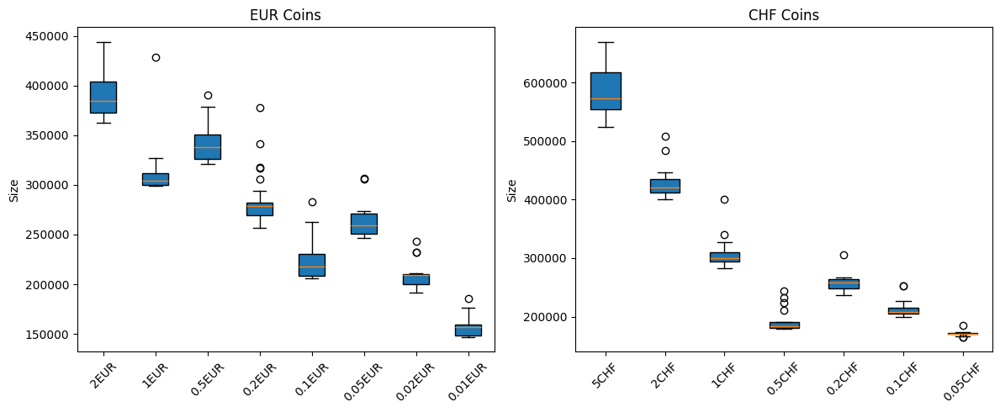

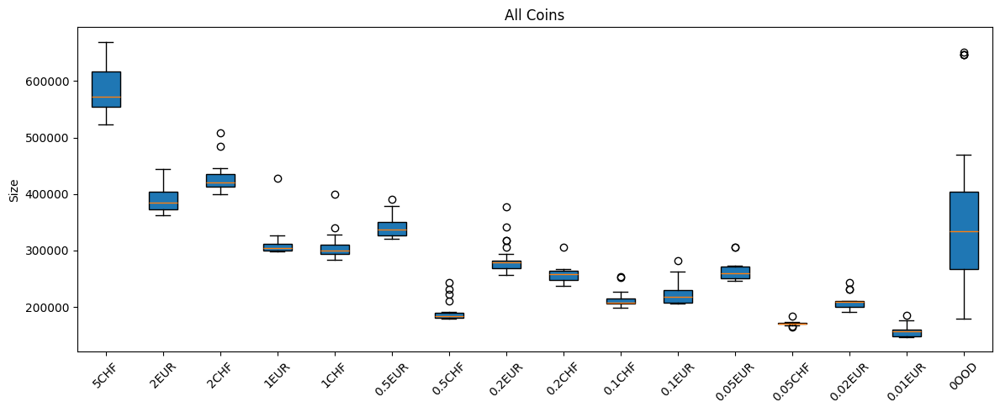

In [62]:
def calculate_sizes(dataset):
    # Dictionary to hold sizes: {label: [list of non-black pixel counts for each coin]}
    size_dict = defaultdict(list)

    # Iterate through the dataset
    for image_tensor, label in dataset:
        # Check non-black pixels. Assuming the tensor is in the format C x H x W
        # We consider a pixel non-black if any of its RGB values are not zero
        non_black_pixels = torch.count_nonzero(torch.any(image_tensor > 0, dim=0))
        size_dict[label].append(non_black_pixels.item())  # Append count of non-black pixels for each coin

    return size_dict


coin_data = calculate_sizes(full_dataset)


eur_coins = {key: value for key, value in coin_data.items() if 'EUR' in key}
eur_coins = {k: v for k, v in sorted(eur_coins.items(), key=lambda item: float(item[0].replace('EUR', '')), reverse=True)}

chf_coins = {key: value for key, value in coin_data.items() if 'CHF' in key}
chf_coins = {k: v for k, v in sorted(chf_coins.items(), key=lambda item: float(item[0].replace('CHF', '')), reverse=True)}

coin_data['0OOD'] = coin_data.pop('OOD')
all_coins = {k: v for k, v in sorted(coin_data.items(), key=lambda item: float(item[0].rstrip('EURCHF_T_HOOD')), reverse=True)}
coin_data['OOD'] = coin_data.pop('0OOD')

def create_boxplot(data_dicts, titles):
    # Determine the number of datasets
    n = len(data_dicts)
    
    # Create a figure and axes with 1 row and n columns
    fig, axes = plt.subplots(nrows=1, ncols=n, figsize=(12, 5))
    
    # Ensure axes is always iterable, even when n is 1
    if n == 1:
        axes = [axes]  # Make a single axis object iterable

    # Iterate over each dataset and corresponding axis
    for ax, data_dict, title in zip(axes, data_dicts, titles):
        # Create the boxplot on the current axis
        ax.boxplot(list(data_dict.values()), labels=list(data_dict.keys()), patch_artist=True)
        ax.set_title(title)
        ax.set_ylabel('Size')
        ax.tick_params(axis='x', rotation=45)  # Rotate x labels for better readability

    plt.tight_layout()  # Adjust layout to prevent overlap
    plt.show()

# Call the function with both datasets
create_boxplot([eur_coins, chf_coins], ['EUR Coins', 'CHF Coins'])

create_boxplot([all_coins], ['All Coins'])

We observe that some coins are clearly identifiable by size. For example, 5CHF coins are bigger than the rest of the coins, while 0.01EUR and 0.05CHF are the smallest coins. However, the huge span of sizes among the OOD difficult the classification of coins by size. We may still use size as a metric to consider the final choice for coin classification, but cannot make decision based on it. Because of this, we finally decided not to explicitely consider size. However, by using the black padding explained before, we expect our DL model to still consider size as a parameter.

## Color Information

We also considered looking at the color of the coins. We know that some coins have a copper color (like lowest EUR and CHF coins). In the plots below we plot the 9 color channels to see if we can infer something from them.

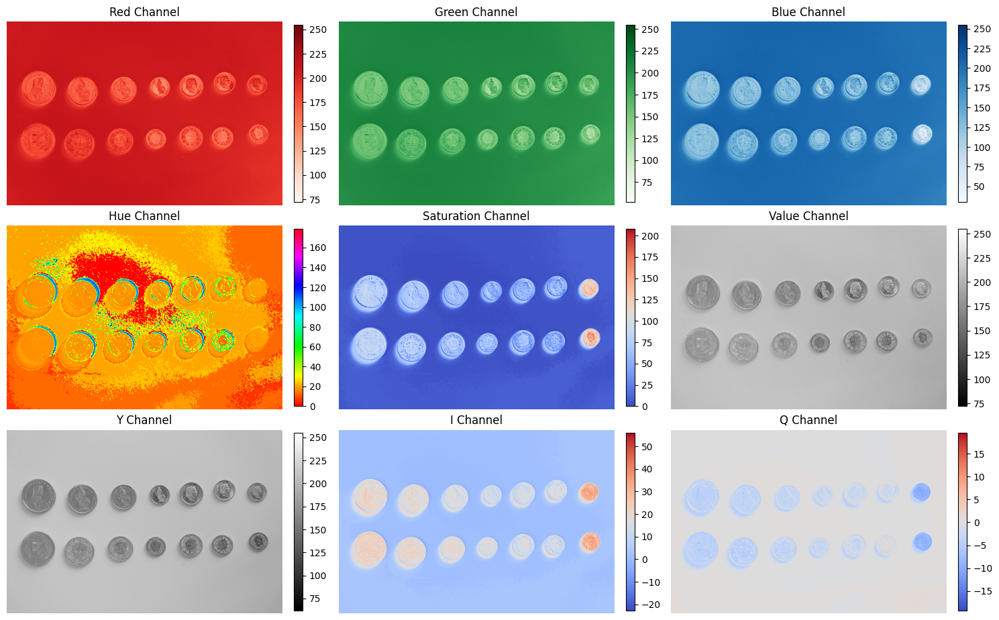

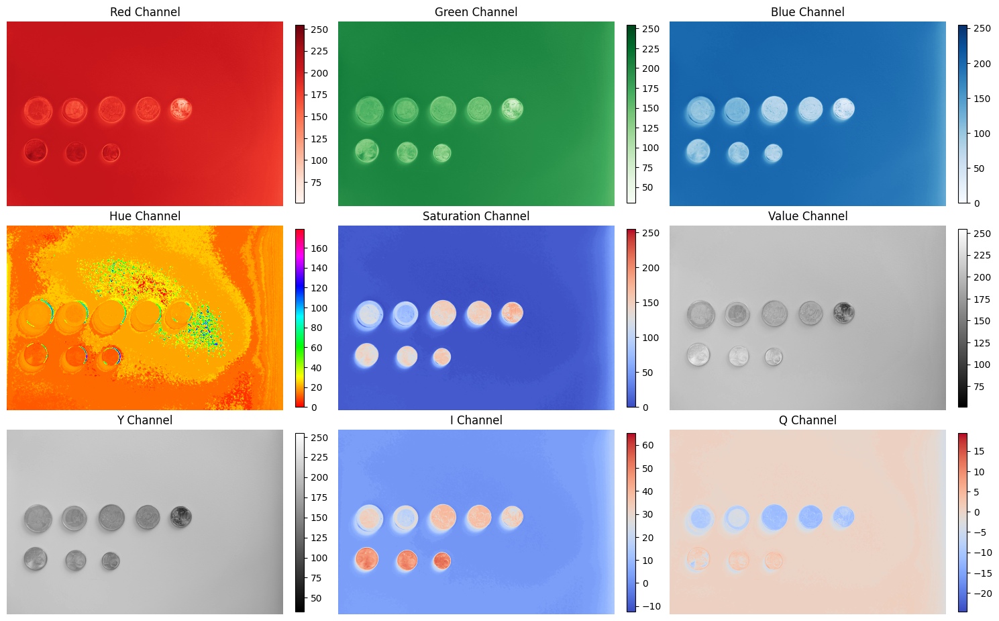

In [63]:
im1 = cv2.imread('ref/ref_chf.JPG', cv2.IMREAD_COLOR)
hsv_im1, yiq_im1 = plot_9_channels(im1)
im2 = cv2.imread('ref/ref_eur.JPG', cv2.IMREAD_COLOR)
hsv_im2, yiq_im2 = plot_9_channels(im2)

As with size, some conclusion can be drawn, like the color of the cents of EUR and CHF. However, not much additional information is given. Additionally, the color of OOD may be the same as of some of these coins.

## Combination of Size and Color

In this section, we attempted to create scatter plots comparing the size of the coins with the peak value indices and the standard deviations of their RGB histograms. Our goal was to visualize and identify any potential clusters, but unfortunately, we did not observe any distinct groupings.

Number of results: 382
16
{'5CHF': 'tab:blue', '2CHF': 'tab:orange', '1CHF': 'tab:green', '0.5CHF': 'tab:red', '0.2CHF': 'tab:purple', '0.1CHF': 'tab:brown', '0.05CHF': 'tab:pink', '2EUR': 'tab:gray', '1EUR': 'tab:olive', '0.5EUR': 'tab:cyan', '0.2EUR': 'tab:blue', '0.1EUR': 'tab:orange', '0.05EUR': 'tab:green', '0.02EUR': 'tab:red', '0.01EUR': 'tab:purple', 'OOD': 'tab:brown'}


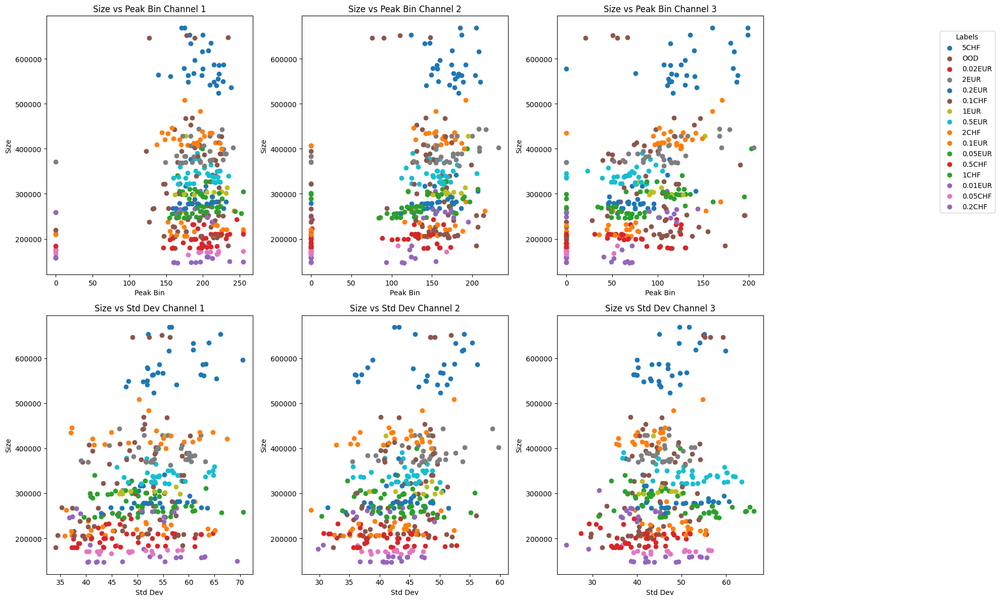

In [64]:
def calculations(image_tensor):
    # Convert tensor to PIL Image for easier manipulation
    to_pil = ToPILImage()
    image = to_pil(image_tensor)

    # Convert image to numpy array
    image_array = np.array(image)

    # Filter out black pixels (where all RGB values are 0)
    mask = np.all(image_array == [0, 0, 0], axis=-1)
    filtered_image_array = image_array[~mask]

    histograms = []
    peak_bins = []
    std_devs = []
    
    for i in range(3):  # R, G, B channels
        histogram, _ = np.histogram(
            filtered_image_array[:, i], bins=256, range=(0, 255))
        # Set histogram values exactly at or above 5000 to 0
        histogram[histogram > 5500] = 0
        histograms.append(histogram)
        
        # Calculate the peak bin
        peak_bin = np.argmax(histogram)
        peak_bins.append(peak_bin)
        
        # Calculate the standard deviation
        pixel_values = np.arange(256)
        total_pixels = histogram.sum()
        if total_pixels > 0:
            mean = np.sum(pixel_values * histogram) / total_pixels
            variance = np.sum(histogram * (pixel_values - mean) ** 2) / total_pixels
            std_dev = np.sqrt(variance)
        else:
            std_dev = 0
        std_devs.append(std_dev)

    #size = torch.count_nonzero(torch.any(image_tensor > 0, dim=0))
    size = torch.count_nonzero(torch.any(image_tensor > 0, dim=0)).item()
    return histograms, peak_bins, std_devs, size


results = []
for idx in range(len(full_dataset)):
    image_tensor, label = full_dataset[idx]
    histograms, peak_bins, std_devs, size = calculations(image_tensor)
    results.append((label, peak_bins, std_devs, size))

print(f"Number of results: {len(results)}")

# Define 16 distinct colors
color_list = [
    'tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink',
    'tab:gray', 'tab:olive', 'tab:cyan', 'tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown'
]

# Provided label map
label_map = {
    '5CHF': 0, '2CHF': 1, '1CHF': 2, '0.5CHF': 3, '0.2CHF': 4, '0.1CHF': 5, '0.05CHF': 6,
    '2EUR': 7, '1EUR': 8, '0.5EUR': 9, '0.2EUR': 10, '0.1EUR': 11, '0.05EUR': 12, '0.02EUR': 13, '0.01EUR': 14, 'OOD': 15
}

# Map labels to colors using the label_map
label_colors = {label: color_list[idx] for label, idx in label_map.items()}
print(len(label_colors))
print(label_colors)  # Verify the mapping of labels to colors

fig, axes = plt.subplots(2, 3, figsize=(18, 12))
axes = axes.flatten()

# Plot each channel peak and std dev versus size
for i in range(3):
    # Peak bins
    ax = axes[i]
    ax.set_title(f"Size vs Peak Bin Channel {i+1}")
    ax.set_xlabel("Peak Bin")
    ax.set_ylabel("Size")

    # Std deviations
    ax2 = axes[i + 3]
    ax2.set_title(f"Size vs Std Dev Channel {i+1}")
    ax2.set_xlabel("Std Dev")
    ax2.set_ylabel("Size")

    for label, peak_bins, std_devs, size in results:
        color = label_colors[label]  # Get the color for the label

        # Plotting on first axis (peak bins)
        ax.scatter(peak_bins[i], size, color=color, label=label if label not in ax.get_legend_handles_labels()[1] else "")

        # Plotting on second axis (std devs)
        ax2.scatter(std_devs[i], size, color=color, label=label if label not in ax2.get_legend_handles_labels()[1] else "")

# Only add legend to the first plot
handles, labels = axes[0].get_legend_handles_labels()
unique_labels = list(dict.fromkeys(labels))
unique_handles = [handles[labels.index(lbl)] for lbl in unique_labels]
fig.legend(unique_handles, unique_labels, loc='upper right', title="Labels", bbox_to_anchor=(1.1, 0.95))

plt.tight_layout(rect=[0, 0, 0.85, 1])
plt.show()


## OOD

We have talked about how OOD difficult segmentation. Let's visualize all the OOD coins.

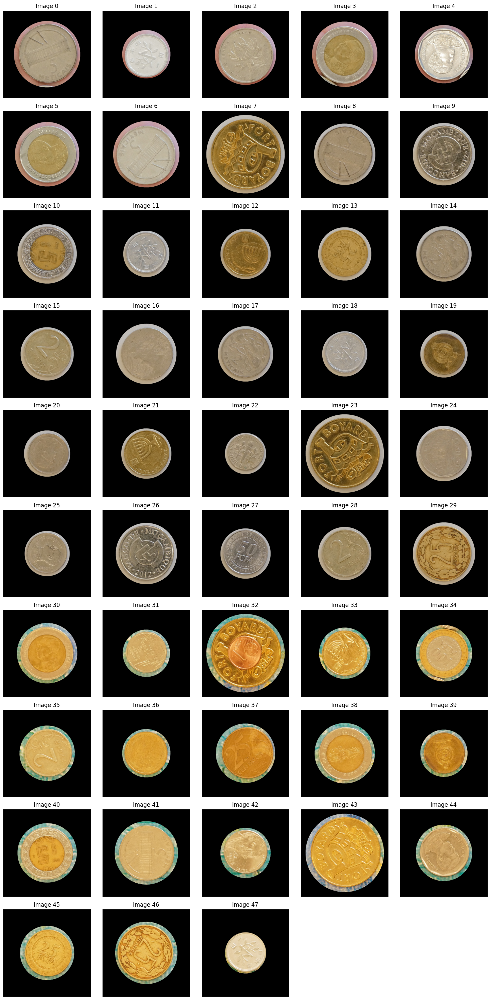

In [65]:
# Define the number of columns for the grid
num_columns = 5

# Filter the dataset to include only images with the label 'OOD'
ood_images = [full_dataset[i][0] for i in range(len(full_dataset)) if full_dataset[i][1] == 'OOD']

# Calculate the number of rows needed
num_rows = len(ood_images) // num_columns + (len(ood_images) % num_columns > 0)

# Create a figure and a set of subplots
fig, axs = plt.subplots(num_rows, num_columns, figsize=(15, 3 * num_rows))

# Flatten the axes array for easy iteration
axs = axs.flatten()

# Loop through each OOD image and each subplot axis
for i, ax in enumerate(axs):
    if i < len(ood_images):
        # Extract the tensor
        image_tensor = ood_images[i]
        
        # Check if the tensor has the right dimensions
        if image_tensor.ndim != 3:
            raise ValueError(f"Image tensor at index {i} does not have 3 dimensions, it has {image_tensor.ndim}")
        
        # Convert tensor to numpy array if it isn't already
        if not isinstance(image_tensor, np.ndarray):
            image_tensor = image_tensor.numpy()
        
        # Transpose the tensor to match (height, width, channels)
        image_tensor = np.transpose(image_tensor, (1, 2, 0))
        
        # Plot the image
        ax.imshow(image_tensor)
        ax.set_title(f"Image {i}")
        ax.axis('off')  # Hide the axis
    else:
        # Hide any extra subplots
        ax.axis('off')

# Adjust layout
plt.tight_layout()
plt.show()

## Data Augmentation

Based on the results seen over the Feature Extraction section, we decided to use a CNN.

While not totally related to feature extraction, if we want to implement our CNN, we need to augment our data. Although we have 382 coins in total, with 16 class, that may fall short. Remember from a plot above, that for some coins, we have as few as just 10 samples. Because of this, we augment the data set in such a way that the minority classes are augmented more, such that the final distribution is balanced.

This will allow our model to generalize better to unseen data. We perform transformations that, while maintaining the label, and inherent properties of the coins, differentiate in ways the same ways as we expect the unseen data to appear. Specifically, we apply (with a certain probability each):

- Random Rotation: as we expect coins to appear in any angle (any angle, up to 360 degrees).
- Gaussian Blur: we saw coins appear with many different resolutions (camera lense is not perfect), and we expect unseen coins to appear with different blur levels.
- Brightness: for the same reasons as Blur.
- Translation: while all coins will be centered in the 1000x1000 image, some of these coins may not be perfectly centered in the sense that the circle used to extract the patch may not perfectly fit the coin, making it appear translated. To account for this, we apply a random rotation.

The `get_transformations()` function constructs the sequence of image transformations and returns the combined transformation pipeline. The `save_transformed_image(image, transform, image_name, transform_id, combined_augmented)` function applies a given transformation to an image, saves the transformed image with a unique name indicating the transformation applied, and returns the name of the saved file. The `process_and_save_sharpened_image(image_path, combined_augmented, image_name)` function reads an image from a specified path, converts it to grayscale, enhances its contrast using CLAHE, sharpens the image using a specific kernel, and saves the sharpened image, returning the path of the saved image. Lastly, the `transform_images_from_csv(csv_file, transformations, label_counts_before, image_folder, combined_augmented, min_required_images=1000)` functions puts all of these together.

On top of this, we make the images grayscale, and use a Kernel to sharpen the images. We convert to grayscale for several reasons:

1) Reduce the dimensionality of the image for training.
2) Apply cv2.createCLAHE to enhance the contrast (which requires one-channel images).


Finally, note that by setting a minimum number of images per class, and augmenting based on that, we aim to obtain a more balanced dataset.

In [66]:
data_augmentation = True

In [24]:
# Define the folder and CSV file paths
image_folder = 'PATCHES/COMBINED' # combined_patches_folder
csv_file = 'PATCHES/COMBINED_LABELS.csv' # data_labels
combined_augmented = 'PATCHES/COMBINED_AUGMENTED'
os.makedirs(combined_augmented, exist_ok=True)
new_csv_file = 'augmented_data.csv'

In [68]:
def get_transformations():
    flip_transformations = [transforms.RandomHorizontalFlip(p=1), transforms.RandomVerticalFlip(p=1)]
    blur_transformation = transforms.GaussianBlur(kernel_size=5, sigma=(0.1, 1.0))
    brightness_transformation = transforms.ColorJitter(brightness=(0.8, 1.2))
    translation_transformations = transforms.RandomAffine(degrees=0, translate=(0.1, 0.1))

    # Combine transformations with RandomApply
    transformations = transforms.Compose([
        transforms.RandomRotation(degrees=(0, 360)),
        transforms.RandomApply(flip_transformations, p=0.5),
        transforms.RandomApply([blur_transformation], p=0.5),
        transforms.RandomApply([brightness_transformation], p=0.5),
        transforms.RandomApply([translation_transformations], p=0.5),
    ])

    return transformations

def save_transformed_image(image, transform, image_name, transform_id, combined_augmented): 
    transformed_image = transform(image)
    transformed_image_name = f"{image_name}_trans{transform_id}.jpg"
    transformed_image_path = os.path.join(combined_augmented, transformed_image_name)
    transformed_image.save(transformed_image_path)
    return transformed_image_name

def process_and_save_sharpened_image(image_path, combined_augmented, image_name):
    # Load the image
    image = cv2.imread(image_path)
    
    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Enhance contrast using CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    contrast_enhanced = clahe.apply(gray)
    
    # Sharpen the image
    kernel = np.array([[0, -1, 0],
                       [-1, 5, -1],
                       [0, -1, 0]])
    sharpened = cv2.filter2D(contrast_enhanced, -1, kernel)
    
    # Save the sharpened image
    sharpened_image_path = os.path.join(combined_augmented, image_name)
    cv2.imwrite(sharpened_image_path, sharpened)
    
    return sharpened_image_path

In [69]:
def transform_images_from_csv(csv_file, transformations, label_counts_before, image_folder, combined_augmented, min_required_images=1000):
    new_data = []

    # Process each image in the dataset
    for _, row in tqdm(csv_file.iterrows()):
        image_name = row['image']
        label = row['label']
        image_path = os.path.join(image_folder, image_name)
        
        # Process and save the sharpened image
        sharpened_image_path = process_and_save_sharpened_image(image_path, combined_augmented, image_name)

        # Open the original image for transformation
        image = Image.open(sharpened_image_path).convert('RGB')
        
        # Add the original image to the new data list
        new_data.append([image_name, label])
        
        # Calculate how many times we need to augment this image
        current_count = label_counts_before[label]
        augment_times = (min_required_images - current_count + len(csv_file[csv_file['label'] == label]) - 1) // len(csv_file[csv_file['label'] == label])

        for i in range(augment_times):
            transformed_image_name = save_transformed_image(image, transformations, image_name.split('.')[0], f"rand{i}", combined_augmented)
            new_data.append([transformed_image_name, label])
        label_counts_before[label] += augment_times

    return new_data

Performing all the transformations may take up to 20min to run

In [70]:
transformations = get_transformations()
min_required_images = 1000
label_counts_before = Counter(data_labels['label'])

if data_augmentation:
    new_data = transform_images_from_csv(data_labels, transformations, label_counts_before, image_folder, 
                                        combined_augmented, min_required_images=min_required_images)

    new_data_df = pd.DataFrame(new_data, columns=['image', 'label'])
    new_data_df.to_csv(new_csv_file, index=False)

    label_counts_after = Counter(new_data_df['label'])
    print("\nNumber of images per class after augmentation:")
    for label, count in label_counts_after.items():
        print(f"{label}: {count}")

    print(f"\nData augmentation completed. New images and CSV file saved in '{combined_augmented}' and '{new_csv_file}' respectively.")

else:
    print("Data augmentation is disabled.")

382it [10:27,  1.64s/it]


Number of images per class after augmentation:
5CHF: 657
OOD: 670
0.02EUR: 655
2EUR: 659
0.2EUR: 659
0.1CHF: 654
1EUR: 658
0.5EUR: 661
2CHF: 655
0.1EUR: 655
0.05EUR: 660
0.5CHF: 655
1CHF: 657
0.01EUR: 654
0.05CHF: 655
0.2CHF: 656

Data augmentation completed. New images and CSV file saved in 'PATCHES/COMBINED_AUGMENTED' and 'augmented_data.csv' respectively.


# 3. Classification

We use the pre-trained **AlexNet 1K**.

Remember that we already defined the Dataset function before. Before creating the datasets, let's define how to separate training and validation data (for test data we use the set with no labels, used for the Kaggle competition).

It is important to note that we cannot simply choose a percentage for validation. As we use a set of transformed images, we may be taking as validation images transformation of train images, which is not adequate. The cell below aims to solve this, by taking as validation only original images, and ensuring that their transformations are not being used for training.

We also use a stratified division to ensure that, using 80% as train dataset, we take 80% of each class for training, avoiding dataset imbalance.

In [22]:
train_model_run = False

In [33]:
data_labels_augmented = pd.read_csv(new_csv_file) 

def remove_pattern(filename):
    pattern = r'(_transrand\d+)?\.jpg$'
    new_filename = re.sub(pattern, '', filename)
    return new_filename

# Separate original from transformed images
original_data = data_labels_augmented[~data_labels_augmented['image'].str.contains('transrand')].reset_index(drop=True)
transformed_data = data_labels_augmented[data_labels_augmented['image'].str.contains('transrand')].reset_index(drop=True)

sss = StratifiedShuffleSplit(n_splits=1, test_size=0.20, random_state=42)
train_idx, val_idx = next(sss.split(np.zeros(len(original_data)), original_data['label']))

train_original = original_data.iloc[train_idx]
val_original = original_data.iloc[val_idx].reset_index(drop=True)

train_transformed = transformed_data[transformed_data['image'].apply(remove_pattern).isin(train_original['image'].apply(remove_pattern))]
val_transformed = transformed_data[transformed_data['image'].apply(remove_pattern).isin(val_original['image'].apply(remove_pattern))]

# Concatenate train
train_data = pd.concat([train_original, train_transformed]).reset_index(drop=True).sample(frac=1).reset_index(drop=True)
val_data = val_original.sample(frac=1).reset_index(drop=True)

We may now create the train and val datasets. Note that again we apply some transformations. While this may seem redundant, as our model is prone to overfitting, this helped to reduce it. We only use very simple transformations in this case (flips and rotations), which minimally change the image.

However, other types of transformations must be explained:

- The image is converted into a tensor. This is needed for PyTorch
- Resize: the image is resized. Originally 1000x1000, AlexNet recommends images 227x277 but we found it to be lacking resolution. 
- We use a normalization procedure typically used in models like AlexNet.


Finally, we also create the dataloaders. For training, we use a relatively small batch size of 8, to promote generalizability and reduce overfitting. For validation, we use 1 (we could use other values, for validation it is not very important to define a specific batch size, but with batch size 1 it is easier to retrieve individual coins for testing purposes).

In [34]:
def sharpen(img):
    enhancer = ImageEnhance.Sharpness(img)
    img = enhancer.enhance(10.0)  # Increase sharpness by a factor of 2.0
    return img

def check_image_size(img):
    if img.size != (1000, 1000):
        raise ValueError("Image must be 1000x1000 in size")
    return img

image_size = 1000

data_transforms = transforms.Compose([
    transforms.Lambda(check_image_size),
    transforms.Resize((image_size, image_size)),
    transforms.RandomRotation(180),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
#     transforms.Lambda(lambda img: sharpen(img)),  # Custom sharpening
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

val_transforms = transforms.Compose([
    transforms.Lambda(check_image_size),
    transforms.Resize((image_size, image_size)),
#     transforms.Lambda(lambda img: sharpen(img)),  # Custom sharpening
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])


full_dataset = CoinDataset(
    csv_file=data_labels_augmented,
    root_dir=combined_augmented,
    transform=data_transforms,
    train=True
)

train_dataset = CoinDataset(
    csv_file=train_data,
    root_dir=combined_augmented,
    transform=data_transforms,
    train=True
)

val_dataset = CoinDataset(
    csv_file=val_data,
    root_dir=combined_augmented,
    transform=val_transforms,
    train=True
)

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=1, shuffle=True)

### Explore Dataset

Double check that the labels have indeed the same order as the dataset randomly in 100 images. Nothing should be printed.

In [74]:
for _ in tqdm(range(100)):
    k = random.randint(0, len(full_dataset) - 1)
    if reversed_class_names[full_dataset[k][1]]!=data_labels_augmented['label'][k]:
        raise ValueError(f'Error in label at index {k}', reversed_class_names[full_dataset[k][1]], data_labels_augmented['label'][k])
    if full_dataset[k][0].shape != (3, image_size, image_size):
        raise ValueError(f'Error in size at index {k}', full_dataset[k][0].shape)

100%|██████████| 100/100 [00:04<00:00, 20.34it/s]


[6482, 7517, 2340, 4339, 2287]


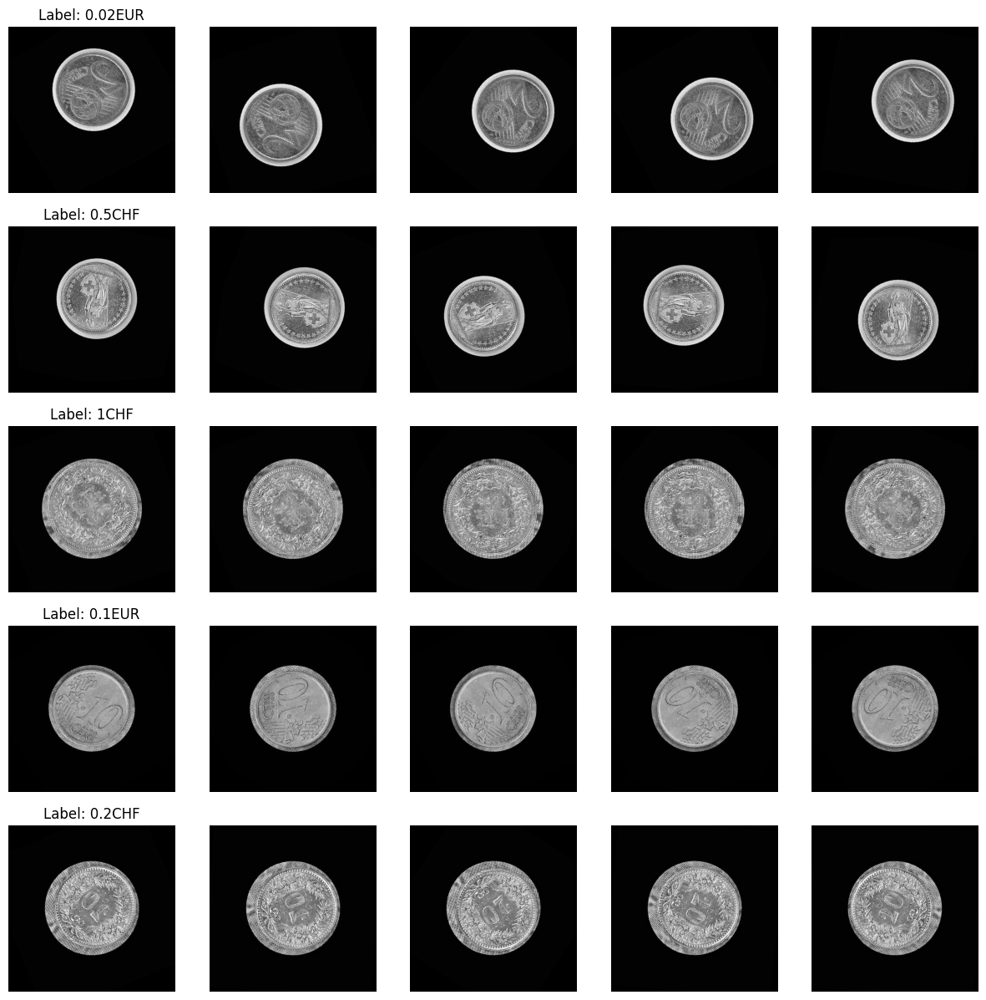

In [75]:
def plot_transformed_images(dataset, num_indices, num_samples=5):
    plt.figure(figsize=(15, 3 * num_indices))  # Adjust figure size to accommodate multiple rows
    selected_indices = random.sample(range(len(dataset)), num_indices)  # Randomly select indices from dataset

    print(selected_indices)
    count = 1  # Start a counter for subplot indexing
    for idx in selected_indices:
        label = dataset[idx][1]  # Retrieve the label of the image
        for i in range(num_samples):
            image = dataset[idx][0]
            image = image.permute(1, 2, 0)  # Change from (C, H, W) to (H, W, C) for plotting
            image = image * torch.tensor([0.229, 0.224, 0.225]) + torch.tensor([0.485, 0.456, 0.406])  # Unnormalize
            image = image.numpy()
            ax = plt.subplot(num_indices, num_samples, count)
            plt.imshow(image)
            plt.axis('off')
            if i == 0:  # Add the label as a title to the first subplot in each row
                ax.set_title(f"Label: {reversed_class_names[label]}")
            count += 1  # Increment counter for each subplot
    plt.show()

plot_transformed_images(train_dataset, num_indices=5, num_samples=5)

Ensure the same % of each class is used for training and validation. With this code, we can also check how many samples are being used for training and validation.

In [76]:
# Now, you can use the DataLoader directly:
class_counts = original_data['label'].value_counts()
classes_train = original_data['label'][train_idx].value_counts()
classes_val = original_data['label'][val_idx].value_counts()

# Dataframe with class_counts, classes_train, classes_test
class_counts_df = pd.DataFrame({
    'Class': class_names.keys(),
    'Total': [class_counts[i] for i in class_names.keys()],
    'Train': [classes_train[i] for i in class_names.keys()],
    'Val': [classes_val[i] for i in class_names.keys()],
    'Train Augm.': [train_data['label'].value_counts()[i] for i in class_names.keys()],
})

# Set 'Class' as the index
class_counts_df.set_index('Class', inplace=True)
class_counts_df['% Training'] = ((class_counts_df['Train'] / class_counts_df['Total'])*100).round(2)
class_counts_df

,Total,Train,Val,Train Augm.,% Training
Class,,,,,
5CHF,28,22,6,528,78.57
2CHF,22,18,4,540,81.82
1CHF,21,17,4,503,80.95
0.5CHF,19,15,4,517,78.95
0.2CHF,11,9,2,489,81.82
0.1CHF,18,14,4,522,77.78
0.05CHF,16,13,3,525,81.25
2EUR,32,26,6,559,81.25
1EUR,10,8,2,514,80.00


## Training Setup

In [7]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

We include the following functions:

- plot_performance
- train_epoch
- validate_model
- train_model

`plot_performance` is a simple function to visualize loss and F1 score over both train and val sets over epochs.

In [8]:
def plot_performance(epochs, training_loss, training_f1, validation_loss, validation_f1):
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(epochs, training_loss, 'bo-', label='Training Loss')
    plt.plot(epochs, validation_loss, 'ro-', label='Validation Loss')
    plt.title('Training & Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(epochs, training_f1, 'bo-', label='Training F1 Score')
    plt.plot(epochs, validation_f1, 'ro-', label='Validation F1 Score')
    plt.title('Training & Validation F1 Score')
    plt.xlabel('Epoch')
    plt.ylabel('F1 Score')
    plt.legend()

    plt.tight_layout()
    plt.show()


`train_epoch` iterates through the dataloader once. The only point worth noting here is that we clip the norm of the gradients to avoid unfeasible gradients that may affect convergence.  

In [9]:
def train_epoch(model, train_loader, criterion, optimizer, device, scheduler=None):
    model.to(device)
    model.train()
    
    running_loss = 0.0
    all_labels = []
    all_predictions = []

    for inputs, labels in tqdm(train_loader, desc="Training", unit="batch"):
        inputs, labels = inputs.to(device), labels.to(device)
        
        optimizer.zero_grad()
        outputs = model(inputs)
        
        loss = criterion(outputs, labels)
        loss.backward()
        
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        optimizer.step()

        running_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())

    if scheduler:
        scheduler.step()

    train_f1 = f1_score(all_labels, all_predictions, average='macro')
    return running_loss / len(train_loader), train_f1


`validate_model` calculates the f1 score and loss on the validation set.

In [10]:
def validate_model(model, val_loader, criterion, device):
    model.eval()
    val_loss = 0.0
    all_labels = []
    all_predictions = []
    with torch.no_grad():
        for inputs, labels in tqdm(val_loader, desc="Validating", unit="batch"):
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            val_loss += loss.item()

            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.cpu().numpy())
            all_predictions.extend(predicted.cpu().numpy())

    val_f1 = f1_score(all_labels, all_predictions, average='macro')
    return val_loss / len(val_loader), val_f1

`train_model` trains the model. We save the model with the highest F1 score on the validation set.

In [11]:
def train_model(model, train_loader, val_loader, criterion, optimizer, device, scheduler=None, num_epochs=10):
    training_losses = []
    validation_losses = []
    training_f1s = []
    validation_f1s = []
    best_val_f1 = 0

    for epoch in range(num_epochs):
        train_loss, train_f1 = train_epoch(model, train_loader, criterion, optimizer, device, scheduler)
        val_loss, val_f1 = validate_model(model, val_loader, criterion, device)
        
        training_losses.append(train_loss)
        validation_losses.append(val_loss)
        training_f1s.append(train_f1)
        validation_f1s.append(val_f1)
        
        print(f'Epoch {epoch+1}: Train Loss: {train_loss:.4f}, Train F1: {train_f1:.4f}, Val Loss: {val_loss:.4f}, Val F1: {val_f1:.4f}')

        # Save the model if the validation F1 is the best we've seen so far.
        if val_f1 > best_val_f1:
            best_val_f1 = val_f1
            torch.save(model.state_dict(), 'best_model.pth')  # Save the best model

    # Load the best model before returning
    model.load_state_dict(torch.load('best_model.pth'))
    
    # Plotting the performance
    plot_performance(range(1, num_epochs+1), training_losses, training_f1s, validation_losses, validation_f1s)
    
    return model

## Model Setup

In [15]:
epochs = 25
max_lr = 1e-4
min_lr = 1e-8

### AlexNet Embeddings + Downstream Classification

We use the pre-trained AlexNet model. We use a 3 linear layer NN to as a downstream classification of the embeddings obtained with the AlexNet model. We can understand these embeddings as the features (recall step 2. feature extraction).

In [12]:
def AlexNet_Pooling_Dropout(num_classes=16):
    model = models.alexnet(weights=models.AlexNet_Weights.IMAGENET1K_V1)
    
    model.avgpool = nn.AdaptiveAvgPool2d((6, 6))    

    # Modify the classifier to include Dropout
    model.classifier = nn.Sequential(
        nn.Dropout(0.5),  # Dropout layer added before the first fully connected layer
        nn.Linear(256 * 6 * 6, 4096),
        nn.ReLU(inplace=True),
        nn.Dropout(0.5),  # Additional Dropout layer before the second fully connected layer
        nn.Linear(4096, 4096),
        nn.ReLU(inplace=True),
        nn.Linear(4096, num_classes)
    )

    return model

In [13]:
model = AlexNet_Pooling_Dropout()
model.to(device);

### Optimizer.

We use the well-known AdamW.

In [16]:
optimizer = optim.AdamW(model.parameters(), lr=max_lr, weight_decay=0.2)

### Scheduler

We propose a cosine annealing scheduler with warmup. Warmup avoids large gradient updates at the beginning of training, which can cause instability. Cosine annealing after this warmup brings a smooth decrease in the learning rate.

In [17]:
class CosineAnnealingWarmUp:
    def __init__(self, optimizer, warmup_epochs, total_epochs, max_lr, min_lr):
        self.optimizer = optimizer
        self.warmup_epochs = warmup_epochs
        self.total_epochs = total_epochs
        self.max_lr = max_lr
        self.min_lr = min_lr
        self.current_epoch = 0

    def step(self):
        if self.current_epoch < self.warmup_epochs:
            lr = self.max_lr * (self.current_epoch + 1) / self.warmup_epochs
        else:
            progress = (self.current_epoch - self.warmup_epochs) / (self.total_epochs - self.warmup_epochs)
            progress_tensor = torch.tensor(progress)
            lr = self.min_lr + 0.5 * (self.max_lr - self.min_lr) * (1 + torch.cos(progress_tensor * torch.pi))

        for param_group in self.optimizer.param_groups:
            param_group['lr'] = lr

        self.current_epoch += 1

In [ ]:
warmup_epochs = 1

scheduler = CosineAnnealingWarmUp(optimizer, warmup_epochs, epochs, max_lr, min_lr)

### Criterion / Loss

Cross Entropy. Typically used for multi-class classification. As there is not the same number of samples per class, we use different weights for each class (penalize more missing instances of underrepresented classes).

In [35]:
train_data_class_num = train_data.copy()
train_data_class_num['label'] = train_data_class_num['label'].map(class_names)
class_counts = train_data_class_num['label'].value_counts().sort_index()
weights = 1.0 / class_counts
weights = weights / weights.sum()
class_weights = torch.tensor(weights.values, dtype=torch.float).to(device)
criterion = torch.nn.CrossEntropyLoss(weight=class_weights)

## Train Model

Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:01<00:00, 163MB/s]
Validating: 100%|██████████| 77/77 [00:02<00:00, 37.96batch/s]


Epoch 1: Train Loss: 0.9951, Train F1: 0.6619, Val Loss: 0.9496, Val F1: 0.8046


Validating: 100%|██████████| 77/77 [00:01<00:00, 45.05batch/s]


Epoch 2: Train Loss: 0.5068, Train F1: 0.8789, Val Loss: 0.9040, Val F1: 0.8594


Validating: 100%|██████████| 77/77 [00:01<00:00, 45.18batch/s]


Epoch 3: Train Loss: 0.3897, Train F1: 0.9223, Val Loss: 0.4550, Val F1: 0.9037


Validating: 100%|██████████| 77/77 [00:01<00:00, 45.21batch/s]


Epoch 4: Train Loss: 0.2871, Train F1: 0.9438, Val Loss: 0.3695, Val F1: 0.9694


Validating: 100%|██████████| 77/77 [00:01<00:00, 47.28batch/s]


Epoch 5: Train Loss: 0.2363, Train F1: 0.9577, Val Loss: 0.5827, Val F1: 0.9326


Validating: 100%|██████████| 77/77 [00:01<00:00, 46.60batch/s]


Epoch 6: Train Loss: 0.2232, Train F1: 0.9608, Val Loss: 0.5017, Val F1: 0.9358


Validating: 100%|██████████| 77/77 [00:01<00:00, 45.05batch/s]


Epoch 7: Train Loss: 0.1965, Train F1: 0.9668, Val Loss: 0.1464, Val F1: 0.9775


Validating: 100%|██████████| 77/77 [00:01<00:00, 48.61batch/s]


Epoch 8: Train Loss: 0.1589, Train F1: 0.9723, Val Loss: 0.0940, Val F1: 0.9565


Validating: 100%|██████████| 77/77 [00:01<00:00, 47.50batch/s]


Epoch 9: Train Loss: 0.1255, Train F1: 0.9768, Val Loss: 0.1587, Val F1: 0.9455


Validating: 100%|██████████| 77/77 [00:01<00:00, 46.85batch/s]


Epoch 10: Train Loss: 0.1176, Train F1: 0.9801, Val Loss: 0.3387, Val F1: 0.9321


Validating: 100%|██████████| 77/77 [00:01<00:00, 43.67batch/s]


Epoch 11: Train Loss: 0.0911, Train F1: 0.9841, Val Loss: 0.0470, Val F1: 0.9740


Validating: 100%|██████████| 77/77 [00:01<00:00, 47.99batch/s]


Epoch 12: Train Loss: 0.0861, Train F1: 0.9842, Val Loss: 0.3010, Val F1: 0.9755


Validating: 100%|██████████| 77/77 [00:01<00:00, 46.25batch/s]


Epoch 13: Train Loss: 0.0681, Train F1: 0.9881, Val Loss: 0.2683, Val F1: 0.9820


Validating: 100%|██████████| 77/77 [00:01<00:00, 46.84batch/s]


Epoch 14: Train Loss: 0.0455, Train F1: 0.9915, Val Loss: 0.4134, Val F1: 0.9677


Validating: 100%|██████████| 77/77 [00:01<00:00, 45.19batch/s]


Epoch 15: Train Loss: 0.0341, Train F1: 0.9940, Val Loss: 0.2505, Val F1: 0.9760


Validating: 100%|██████████| 77/77 [00:01<00:00, 45.98batch/s]


Epoch 16: Train Loss: 0.0254, Train F1: 0.9950, Val Loss: 0.3507, Val F1: 0.9403


Validating: 100%|██████████| 77/77 [00:01<00:00, 44.86batch/s]


Epoch 17: Train Loss: 0.0228, Train F1: 0.9960, Val Loss: 0.1092, Val F1: 0.9797


Validating: 100%|██████████| 77/77 [00:01<00:00, 47.61batch/s]


Epoch 18: Train Loss: 0.0147, Train F1: 0.9970, Val Loss: 0.2989, Val F1: 0.9671


Validating: 100%|██████████| 77/77 [00:01<00:00, 46.95batch/s]


Epoch 19: Train Loss: 0.0130, Train F1: 0.9976, Val Loss: 0.0503, Val F1: 0.9841


Validating: 100%|██████████| 77/77 [00:01<00:00, 48.24batch/s]


Epoch 20: Train Loss: 0.0103, Train F1: 0.9977, Val Loss: 0.3649, Val F1: 0.9677


Validating: 100%|██████████| 77/77 [00:01<00:00, 46.00batch/s]


Epoch 21: Train Loss: 0.0032, Train F1: 0.9993, Val Loss: 0.1042, Val F1: 0.9882


Validating: 100%|██████████| 77/77 [00:01<00:00, 46.30batch/s]


Epoch 22: Train Loss: 0.0019, Train F1: 0.9995, Val Loss: 0.0177, Val F1: 1.0000


Validating: 100%|██████████| 77/77 [00:01<00:00, 45.01batch/s]


Epoch 23: Train Loss: 0.0025, Train F1: 0.9994, Val Loss: 0.0624, Val F1: 0.9802


Validating: 100%|██████████| 77/77 [00:01<00:00, 41.32batch/s]


Epoch 24: Train Loss: 0.0002, Train F1: 1.0000, Val Loss: 0.0654, Val F1: 0.9802


Validating: 100%|██████████| 77/77 [00:01<00:00, 46.78batch/s]


Epoch 25: Train Loss: 0.0000, Train F1: 1.0000, Val Loss: 0.0056, Val F1: 1.0000


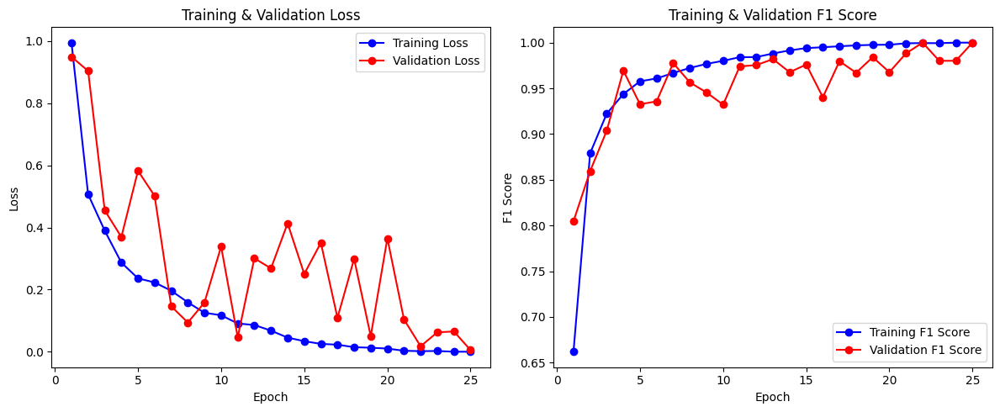

In [ ]:
if train_model_run:
    trained_model = train_model(model, train_loader, val_loader, criterion, optimizer, 
                                num_epochs=epochs, device=device, scheduler=scheduler)

# 4. Test Model and Obtain Results

##### 1. With the same methodology, we can extract the coins for the test set. 

This takes around 1-7 minutes.

In [52]:
# Folder paths
input_folder = test_folder
output_images_folder = 'PROCESSED/TEST_SET_PROCESSED'
output_patches_folder = 'PATCHES/TEST_SET_PATCHES'

# Create output folder if it doesn't exist
if not os.path.exists(output_images_folder):
    os.makedirs(output_images_folder)

# Create output folder if it doesn't exist
if not os.path.exists(output_patches_folder):
    os.makedirs(output_patches_folder)

if create_patches:
    # Process each image in the folder
    for filename in os.listdir(input_folder):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            input_path = os.path.join(input_folder, filename)
            output_images_path = os.path.join(output_images_folder, filename)
            process_image(input_path, output_images_path, output_patches_folder)


Create a csv with the name of each patch in the test set

In [53]:
test_patches_path = 'PATCHES/TEST_SET_PATCHES'

# List all files in the folder
file_names = [f for f in os.listdir(test_patches_path) if os.path.isfile(os.path.join(test_patches_path, f))]

# Create a DataFrame with these file names
test_df = pd.DataFrame(file_names, columns=['image'])

test_df.to_csv('test_set.csv', index=False)

Convert to grayscale, and apply the same "filters" as to the training data.

In [79]:
processed_test_path = 'PATCHES/TEST_SET_PATCHES_PROCESSED'
os.makedirs(processed_test_path, exist_ok=True)

# Initialize a list to store the new data
new_data = []

# Function to process and save the sharpened image
def process_and_save_sharpened_image(image_path, output_folder, image_name):

    # Load the image
    image = cv2.imread(image_path)
    
    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Enhance contrast using CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    contrast_enhanced = clahe.apply(gray)
    
    # Sharpening the image
    kernel = np.array([[0, -1, 0],
                       [-1, 5, -1],
                       [0, -1, 0]])
    sharpened = cv2.filter2D(contrast_enhanced, -1, kernel)
    
    # Save the sharpened image
    sharpened_image_path = os.path.join(output_folder, image_name)
    cv2.imwrite(sharpened_image_path, sharpened)
    
    return sharpened_image_path

# Process each image in the dataset
for idx, row in tqdm(test_df.iterrows()):
    image_name = row['image']
    image_path = os.path.join(test_patches_path, image_name)
    
    # Process and save the sharpened image
    sharpened_image_path = process_and_save_sharpened_image(image_path, processed_test_path, image_name)
    
    # Open the sharpened image for transformation
    image = Image.open(sharpened_image_path).convert('RGB')
    
    # Add the original (sharpened) image to the new data list
    new_data.append([image_name])


868it [00:22, 38.42it/s]


##### 2. Create the dataloader for the test set.

In [54]:
# Define test transformations
test_transforms = transforms.Compose([
    transforms.Resize((1000, 1000)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

test_csv = pd.read_csv('test_set.csv')
# Instantiate the dataset for testing (without labels)
test_dataset = CoinDataset(
    csv_file=test_csv,  # Update this path
    root_dir='PATCHES/TEST_SET_PATCHES_PROCESSED',
    transform=test_transforms,
    train=False
)

# Create a DataLoader for the test dataset
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

# Optionally, check the size of the test DataLoader
print(f"Test loader batches: {len(test_loader)}")


Test loader batches: 868


##### 3. Load the model (saved model on best F1 score on validation set)

In [55]:
# Load saved model "best_model.pth"
model = AlexNet_Pooling_Dropout()
model.load_state_dict(torch.load('best_model.pth', map_location=device))
model.to(device);

##### 4. Anticipate performance of the model. Plot the predictions for some coins

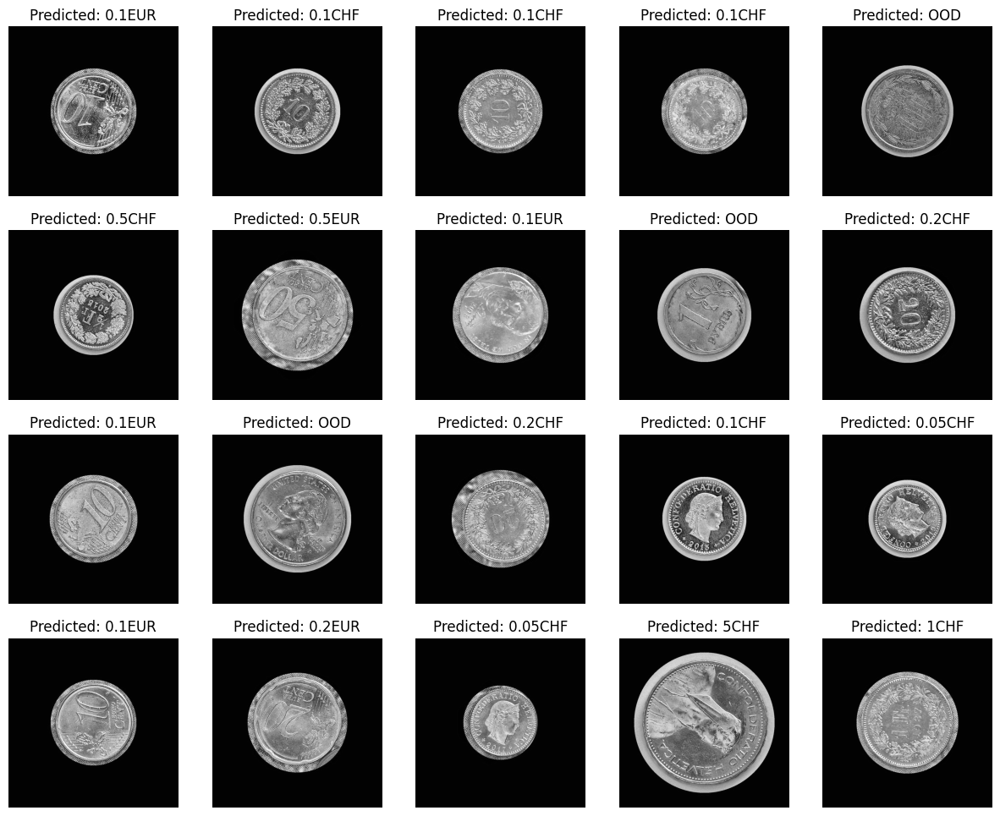

In [56]:
def plot_predictions(loader, num_samples=5, test=True):
    num_rows = (num_samples + 3) // 5  # Ensure enough rows to handle all samples
    num_cols = 5  # Number of columns fixed at 4
    plt.figure(figsize=(15, 3 * num_rows))  # Adjust figure size to accommodate multiple rows

    count = 1  # Start a counter for subplot indexing
    for inputs in loader:
        if count > num_samples:  # Stop processing if the required number of samples has been plotted
            break
        if test:
            inputs = inputs.to(device)
        else:
            inputs = inputs[0].to(device)

        outputs = model(inputs)
        _, predicted = torch.max(outputs.data, 1)
        image = inputs[0].permute(1, 2, 0).cpu() * torch.tensor([0.229, 0.224, 0.225]) + torch.tensor([0.485, 0.456, 0.406])

        ax = plt.subplot(num_rows, num_cols, count)
        plt.imshow(image)
        plt.axis('off')
        ax.set_title(f'Predicted: {reversed_class_names[predicted.item()]}')
        count += 1  # Increment counter for each subplot
    plt.show()

plot_predictions(test_loader, num_samples=20)

##### 5. Predict the coin class of every coin patch in the test set

In [57]:
# Function to validate the model
def test_model(model, test_loader, device):

    model.eval()
    all_predictions = []

    with torch.no_grad():
        for inputs in tqdm(test_loader, desc="Validating", unit="batch"):
            inputs = inputs.to(device)
            outputs = model(inputs)

            _, predicted = torch.max(outputs.data, 1)
            all_predictions.extend(predicted.cpu().numpy())

    return all_predictions

pred_number = test_model(model, test_loader, device)

Validating: 100%|██████████| 868/868 [01:47<00:00,  8.08batch/s]


##### 6. Group Coins in the Same Patch, and Format csv of Results

In [58]:
pred_label = [reversed_class_names[pred] for pred in pred_number]

test_csv['predicted_label'] = pred_label

test_csv.head()

display(test_csv.predicted_label.value_counts())
print(len(test_csv.predicted_label.value_counts()))

predicted_label
OOD        101
0.5CHF      61
2EUR        61
0.5EUR      58
0.1EUR      57
0.1CHF      57
5CHF        56
1CHF        56
0.2CHF      55
2CHF        55
0.05EUR     55
0.2EUR      54
0.02EUR     48
0.05CHF     43
1EUR        26
0.01EUR     25
Name: count, dtype: int64

16


In [59]:
# Pivot table to count occurrences of each label for each image
pivot_df = test_csv.pivot_table(index='image', columns='predicted_label', aggfunc='size', fill_value=0)

# Reorder the columns to ensure they are in the specified order
pivot_df = pivot_df[class_names.keys()]

# Reset index to make the 'image_id' a column again
pivot_df.reset_index(inplace=True)

# Extract the base ID from the image column to group patches of the same image
pivot_df['id'] = pivot_df['image'].apply(lambda x: x.split('_patch')[0])

# Group by the new id column and sum all patches for each image
result_df = pivot_df.groupby('id').sum()

# Reset index to make 'id' a column again
result_df.reset_index(inplace=True)

# Reorder columns (here we just add 'id' at the start)
columns_order = ['id'] + [col for col in pivot_df.columns if col != 'image' and col != 'id']
result_df = result_df[columns_order]

# Save the DataFrame to a CSV
result_df.to_csv('aggregated_patch_counts.csv', index=False)

result_df.head()

predicted_label,id,5CHF,2CHF,1CHF,0.5CHF,0.2CHF,0.1CHF,0.05CHF,2EUR,1EUR,0.5EUR,0.2EUR,0.1EUR,0.05EUR,0.02EUR,0.01EUR,OOD
0,L0000000,0,0,0,0,1,1,0,1,0,0,0,0,0,0,0,0
1,L0000001,0,1,1,1,2,0,1,0,2,1,0,0,1,0,0,0
2,L0000002,2,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0
3,L0000003,0,0,0,2,0,1,1,0,0,0,0,1,0,1,0,2
4,L0000004,0,0,1,1,1,1,0,0,1,0,0,0,0,1,0,0
